<a href="https://colab.research.google.com/github/lisagirard/Snowsports/blob/main/UnSupeLearning_CapstoneIII_SkiingConditions_LisaGirard.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# RESEARCH QUESTION

1. **What conditions contribute to the decision to participate in snowsports (ski/snowboard) at a ski resort?**


##The relative importance of ski resort- and weather-related characteristics when going alpine skiing: data from a rating-based conjoint survey

https://data.mendeley.com/datasets/6w4tzrs3yw

The data are related to two research articles: “The relative importance of ski resort-and weather-related characteristics when going alpine skiing” [1] and “Optimal pricing of alpine ski passes in the case of crowdedness and reduced skiing capacity” [2].  A rating-based conjoint survey experiment on active alpine skiers at a big ski area located in Inland Norway was performed in February of 2018 to collect the data and pertain to 400 respondents doing more than 7200 ratings. A total of ten versions of the same questionnaire type were used to obtain information about preferences on ski resort- and weather-related characteristics when going alpine skiing. We display the raw data organized such that they can be easily downloaded and used directly to either (1) replicate the analyses performed in the related research articles, or (2) run one’s own analyses on the topic of interest. The data may also be useful to lecturers teaching students about the key concepts of survey experiments and causal modelling.   

Haugom, Erik; Malasevska, Iveta; Lien, Gudbrand (2021), “The relative importance of ski resort- and weather-related characteristics when going alpine skiing: data from a rating-based conjoint survey”, Mendeley Data, V1, doi: 10.17632/6w4tzrs3yw.1

[1] https://www.tandfonline.com/doi/full/10.1080/23311886.2019.1681246

[2]https://link.springer.com/article/10.1007/s00181-020-01872-w

In [ ]:
import pandas as pd
import numpy as np
import sklearn 
import matplotlib.pyplot as plt
import seaborn as sns

!pip install kneed
from kneed import KneeLocator

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler

## clustering algos and dimensionality reducers
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import dendrogram
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from sklearn.mixture import GaussianMixture
from sklearn.manifold import TSNE
from sklearn import metrics
!pip install umap-learn
import umap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from scipy import stats
import statistics
from scipy.stats import pearsonr
from scipy.stats.mstats import winsorize
import statsmodels.api as sm
from sklearn.metrics import confusion_matrix


In [ ]:
#pd.set_option('display.max_rows',None)

In [ ]:
#pd.read_csv('data.csv')  
all_data = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/SKIING/norway-skiing-weather-2018-csv.csv")
all_data.head()

,ID,QUESTIONAIRE_CODE,QUESTION,CODE-QUESTION,QUE_TIME,WEKKDAY,PRICE,PERIOD,WEATHER,TEMPERATURE,...,GEAR_OTHER,INCOME,INCOME_L100,INCOME_100-300,INCOME_300-600,INCOME_600-900,INCOME_900-1200,INCOME_M1200,INCOME_NOANSWER,SKIINTERESS
0,1,SLOPES-2,8,BAKKER-28,10,MIDWEEK,250,REGULAR WEEK,SUN,-5,...,0,5.0,0,0,0,0,0,1,0,5.0
1,1,SLOPES-2,8,BAKKER-28,5,MIDWEEK,350,REGULAR WEEK,SUN,-5,...,0,5.0,0,0,0,0,0,1,0,5.0
2,1,SLOPES-2,8,BAKKER-28,5,MIDWEEK,450,REGULAR WEEK,SUN,-5,...,0,5.0,0,0,0,0,0,1,0,5.0
3,1,SLOPES-2,8,BAKKER-28,1,MIDWEEK,550,REGULAR WEEK,SUN,-5,...,0,5.0,0,0,0,0,0,1,0,5.0
4,1,SLOPES-2,8,BAKKER-28,10,WEEKEND,250,REGULAR WEEK,SUN,-5,...,0,5.0,0,0,0,0,0,1,0,5.0


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
all_data.rename(columns = {'WEKKDAY':'WEEKDAY'}, inplace=True)
all_data.rename(columns = {'SKIINTERESS':'SKI_INTEREST'}, inplace=True)
all_data.rename(columns = {'TEMPERATURE':'TEMP_C'}, inplace=True)
all_data.rename(columns = {'TEMP_-20':'TEMP_-20C'}, inplace=True)
all_data.rename(columns = {'TEMP_-15':'TEMP_-15C'}, inplace=True)
all_data.rename(columns = {'TEMP_-10':'TEMP_-10C'}, inplace=True)
all_data.rename(columns = {'TEMP_-5':'TEMP_-5C'}, inplace=True)
all_data.rename(columns = {'TEMP_0':'TEMP_0C'}, inplace=True)
all_data.rename(columns = {'TEMP_P5':'TEMP_5C'}, inplace=True)
all_data.rename(columns = {'SINGEL':'SINGLE'}, inplace=True)
all_data.rename(columns = {'SINGEL_WCHILD':'SINGLE_WCHILD'}, inplace=True)
all_data.columns

Index(['ID', 'QUESTIONAIRE_CODE', 'QUESTION', 'CODE-QUESTION', 'QUE_TIME',
       'WEEKDAY', 'PRICE', 'PERIOD', 'WEATHER', 'TEMP_C', 'WIND',
       'SLOPES_OPEN', 'R8-HELP', 'RATING', 'QUE_1', 'QUE_5', 'QUE_10',
       'MIDWEEK', 'WEEKEND', 'REGULAR_WEEK', 'VACATION', 'P250', 'P350',
       'P450', 'P550', 'P650', 'SUN', 'RAIN', 'SNOW', 'CLOUD', 'FOG',
       'TEMP_-20C', 'TEMP_-15C', 'TEMP_-10C', 'TEMP_-5C', 'TEMP_0C', 'TEMP_5C',
       'NO_WIND', 'GENTLE_BREEZE', 'FRESH_BREEZE', 'SLOPES_50', 'SLOPES_75',
       'SLOPES_100', 'MALE', 'FEMALE', 'AGE', 'HAFJELL_RESIDENCE',
       'SKIING_DAYS_TOTAL', 'SKIING_DAYS_HAFJELL', 'SKIING_MIDWEEK',
       'SKIING_WEEKEND', 'SKIING_CHRISTMAS', 'SKIING_EASTER',
       'SKIING_WINTER-VACATION', 'SKIING_REGULAR_WEEK', 'SKIING_ALL_PERIODS',
       'WORK', 'WORK_FULL_TIME', 'WORK_PART_TIME', 'WORK_UNEMPLOYED',
       'WORK_STUDENT', 'WORK_OTHER', 'FAMILYSTATUS', 'SINGLE', 'SINGLE_WCHILD',
       'COUPLE', 'COUPLE_WCHILD', 'OTHER', 'DISTANCE', 'ANC_SK

In [ ]:
all_data.shape

(7182, 87)

In [ ]:
all_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7182 entries, 0 to 7181
Data columns (total 87 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   ID                      7182 non-null   int64  
 1   QUESTIONAIRE_CODE       7182 non-null   object 
 2   QUESTION                7182 non-null   int64  
 3   CODE-QUESTION           7182 non-null   object 
 4   QUE_TIME                7182 non-null   int64  
 5   WEEKDAY                 7182 non-null   object 
 6   PRICE                   7182 non-null   int64  
 7   PERIOD                  7182 non-null   object 
 8   WEATHER                 7182 non-null   object 
 9   TEMP_C                  7182 non-null   int64  
 10  WIND                    7182 non-null   object 
 11  SLOPES_OPEN             7182 non-null   float64
 12  R8-HELP                 7182 non-null   object 
 13  RATING                  6491 non-null   object 
 14  QUE_1                   7182 non-null   

In [ ]:
all_data.describe(include = 'object')
#THESE GET CONVERTED LATER AS NEEDED

,QUESTIONAIRE_CODE,CODE-QUESTION,WEEKDAY,PERIOD,WEATHER,WIND,R8-HELP,RATING
count,7182,7182,7182,7182,7182,7182,7182,6491
unique,10,20,2,2,5,3,18,67
top,SLOPES-1,BAKKER-18,WEEKEND,REGULAR WEEK,SUN,NO WIND,8_1_rate,0
freq,810,405,3990,6831,3690,5436,399,1158


In [ ]:
#CHECKING FOR NULLS
all_data.isna().sum()

ID                     0
QUESTIONAIRE_CODE      0
QUESTION               0
CODE-QUESTION          0
QUE_TIME               0
                    ... 
INCOME_600-900         0
INCOME_900-1200        0
INCOME_M1200           0
INCOME_NOANSWER        0
SKI_INTEREST         180
Length: 87, dtype: int64

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


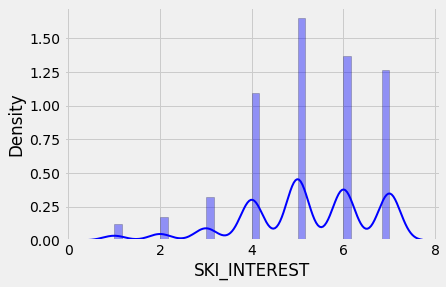

In [ ]:
# CHECKING SOME DISTRIBUTIONS BEFORE ENCODING AND CHANGING DATA
sns.distplot(all_data['SKI_INTEREST'], hist=True, kde=True, 
             bins=int(180/5), color = 'blue', 
             hist_kws={'edgecolor':'black'},
             kde_kws={'linewidth': 2})

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


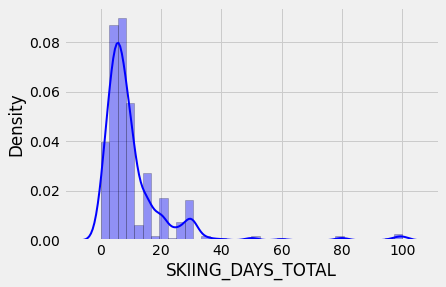

In [ ]:
# CHECKING SOME DISTRIBUTIONS BEFORE ENCODING AND CHANGING DATA
sns.distplot(all_data['SKIING_DAYS_TOTAL'], hist=True, kde=True, 
             bins=int(180/5), color = 'blue', 
             hist_kws={'edgecolor':'black'},
             kde_kws={'linewidth': 2})

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


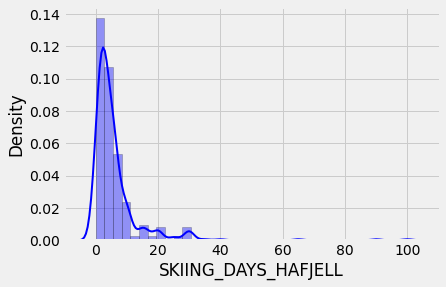

In [ ]:
# CHECKING SOME DISTRIBUTIONS BEFORE ENCODING AND CHANGING DATA
sns.distplot(all_data['SKIING_DAYS_HAFJELL'], hist=True, kde=True, 
             bins=int(180/5), color = 'blue', 
             hist_kws={'edgecolor':'black'},
             kde_kws={'linewidth': 2})

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


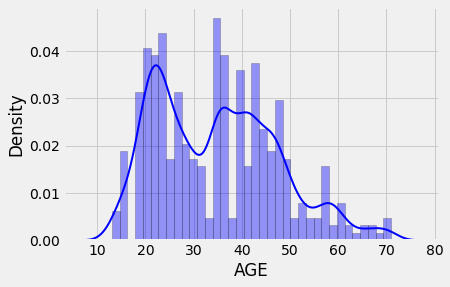

In [ ]:
# CHECKING SOME DISTRIBUTIONS BEFORE ENCODING AND CHANGING DATA
sns.distplot(all_data['AGE'], hist=True, kde=True, 
             bins=int(180/5), color = 'blue', 
             hist_kws={'edgecolor':'black'},
             kde_kws={'linewidth': 2})

In [ ]:
from sklearn.preprocessing import LabelEncoder

In [ ]:
# converting type of OBJECT columns to 'category'
all_data['PERIOD'] = all_data['PERIOD'].astype('category')
all_data['WEATHER'] = all_data['WEATHER'].astype('category')
all_data['WIND'] = all_data['WIND'].astype('category')
all_data['R8-HELP'] = all_data['R8-HELP'].astype('category')
all_data['WEEKDAY'] = all_data['WEEKDAY'].astype('category')
all_data['QUESTIONAIRE_CODE'] = all_data['QUESTIONAIRE_CODE'].astype('category')
all_data['CODE-QUESTION'] = all_data['CODE-QUESTION'].astype('category')
all_data['PERIOD'].dtype

CategoricalDtype(categories=['REGULAR WEEK', 'VACATION'], ordered=False)

In [ ]:
# creating instance of labelencoder
labelencoder = LabelEncoder()
# Assigning numerical values to string/object types
all_data['PERIOD'] = labelencoder.fit_transform(all_data['PERIOD'])
all_data['WEATHER'] = labelencoder.fit_transform(all_data['WEATHER'])
all_data['WIND'] = labelencoder.fit_transform(all_data['WIND'])
all_data['R8-HELP'] = labelencoder.fit_transform(all_data['R8-HELP'])
all_data['WEEKDAY'] = labelencoder.fit_transform(all_data['WEEKDAY'])
all_data['QUESTIONAIRE_CODE'] = labelencoder.fit_transform(all_data['QUESTIONAIRE_CODE'])
all_data['CODE-QUESTION'] = labelencoder.fit_transform(all_data['CODE-QUESTION'])
all_data.head()

,ID,QUESTIONAIRE_CODE,QUESTION,CODE-QUESTION,QUE_TIME,WEEKDAY,PRICE,PERIOD,WEATHER,TEMP_C,...,GEAR_OTHER,INCOME,INCOME_L100,INCOME_100-300,INCOME_300-600,INCOME_600-900,INCOME_900-1200,INCOME_M1200,INCOME_NOANSWER,SKI_INTEREST
0,1,2,8,2,10,0,250,0,4,-5,...,0,5.0,0,0,0,0,0,1,0,5.0
1,1,2,8,2,5,0,350,0,4,-5,...,0,5.0,0,0,0,0,0,1,0,5.0
2,1,2,8,2,5,0,450,0,4,-5,...,0,5.0,0,0,0,0,0,1,0,5.0
3,1,2,8,2,1,0,550,0,4,-5,...,0,5.0,0,0,0,0,0,1,0,5.0
4,1,2,8,2,10,1,250,0,4,-5,...,0,5.0,0,0,0,0,0,1,0,5.0


In [ ]:
all_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7182 entries, 0 to 7181
Data columns (total 87 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   ID                      7182 non-null   int64  
 1   QUESTIONAIRE_CODE       7182 non-null   int64  
 2   QUESTION                7182 non-null   int64  
 3   CODE-QUESTION           7182 non-null   int64  
 4   QUE_TIME                7182 non-null   int64  
 5   WEEKDAY                 7182 non-null   int64  
 6   PRICE                   7182 non-null   int64  
 7   PERIOD                  7182 non-null   int64  
 8   WEATHER                 7182 non-null   int64  
 9   TEMP_C                  7182 non-null   int64  
 10  WIND                    7182 non-null   int64  
 11  SLOPES_OPEN             7182 non-null   float64
 12  R8-HELP                 7182 non-null   int64  
 13  RATING                  6491 non-null   object 
 14  QUE_1                   7182 non-null   

In [ ]:
all_data['RATING'] = all_data['RATING'].fillna(0)
all_data['RATING'].isna().sum()


0

In [ ]:
all_data['RATING'].replace({'AN':0},inplace=True)
# FOUND 'AN' ON ORIGINAL DATA SPREADSHEET LINE 4441

In [ ]:
# convert RATING object to integer
all_data['RATING'].dtype
all_data["RATING"] = all_data["RATING"].astype(str).astype(int)

In [ ]:
all_data['RATING'].iloc[4440:4445]

4440    0
4441    0
4442    0
4443    0
4444    0
Name: RATING, dtype: int64

In [ ]:
all_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7182 entries, 0 to 7181
Data columns (total 87 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   ID                      7182 non-null   int64  
 1   QUESTIONAIRE_CODE       7182 non-null   int64  
 2   QUESTION                7182 non-null   int64  
 3   CODE-QUESTION           7182 non-null   int64  
 4   QUE_TIME                7182 non-null   int64  
 5   WEEKDAY                 7182 non-null   int64  
 6   PRICE                   7182 non-null   int64  
 7   PERIOD                  7182 non-null   int64  
 8   WEATHER                 7182 non-null   int64  
 9   TEMP_C                  7182 non-null   int64  
 10  WIND                    7182 non-null   int64  
 11  SLOPES_OPEN             7182 non-null   float64
 12  R8-HELP                 7182 non-null   int64  
 13  RATING                  7182 non-null   int64  
 14  QUE_1                   7182 non-null   

NOW EVERYTHING IS CONVERTED TO INTS AND FLOATS AND OBJECT LABELS HAVE BEEN ENCODED TO INTS

In [ ]:
# FILLING NANS  WITH 0s
all_data = all_data.fillna(0)

In [ ]:
all_data.isna().sum()

ID                   0
QUESTIONAIRE_CODE    0
QUESTION             0
CODE-QUESTION        0
QUE_TIME             0
                    ..
INCOME_600-900       0
INCOME_900-1200      0
INCOME_M1200         0
INCOME_NOANSWER      0
SKI_INTEREST         0
Length: 87, dtype: int64

# CHECKING FOR OUTLIERS
specificially on continuous variables of: <BR>
* AGE
* SKIING_DAYS_TOTAL
* SKIING_DAYS_HAFJELL

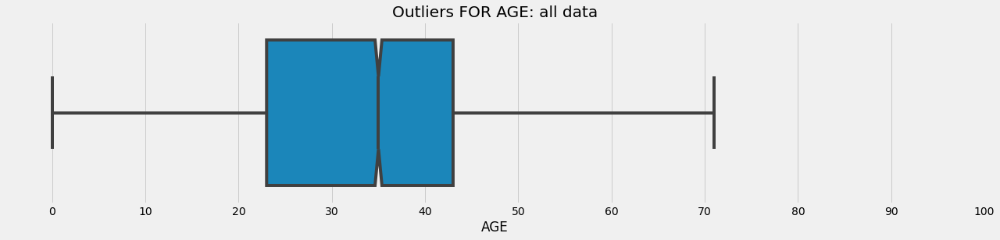

In [ ]:
#chekcing for outliers with boxplot
fig = plt.figure() 
fig.set_size_inches(20,4)
sns.boxplot(x = all_data['AGE'], notch=True)
plt.title("Outliers FOR AGE: all data")
plt.xlim(-5, 100)
plt.locator_params(axis='x', nbins=20)
plt.show()

NO AGE OUTLIERS

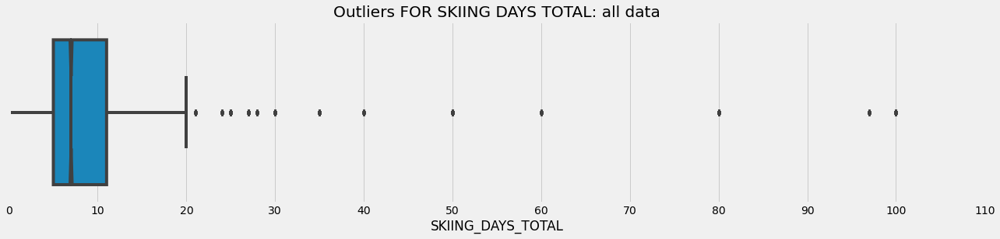

In [ ]:
#chekcing for outliers with boxplot
fig = plt.figure() 
fig.set_size_inches(20,4)
sns.boxplot(x = all_data['SKIING_DAYS_TOTAL'], notch=True)
plt.title("Outliers FOR SKIING DAYS TOTAL: all data")
plt.xlim(0, 110)
plt.locator_params(axis='x', nbins=20)
plt.show()

In [ ]:
all_data['SKIING_DAYS_TOTAL'].describe()

count    7182.000000
mean       10.754386
std        13.166331
min         0.000000
25%         5.000000
50%         7.000000
75%        11.000000
max       100.000000
Name: SKIING_DAYS_TOTAL, dtype: float64

**WILL NOT REMOVE THESE AS OUTLIERS, YET. WILL CONSIDER LATER IF GOING TO CONSIDER SKIING_DAYS_TOTAL IN CLUSTERING**

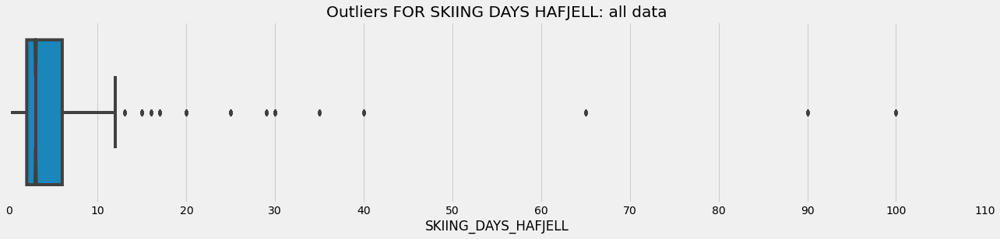

In [ ]:
#chekcing for outliers with boxplot
fig = plt.figure() 
fig.set_size_inches(20,4)
sns.boxplot(x = all_data['SKIING_DAYS_HAFJELL'], notch=True)
plt.title("Outliers FOR SKIING DAYS HAFJELL: all data")
plt.xlim(0, 110)
plt.locator_params(axis='x', nbins=20)
plt.show()

In [ ]:
all_data['SKIING_DAYS_HAFJELL'].describe()

count    7182.000000
mean        6.000000
std         9.409231
min         0.000000
25%         2.000000
50%         3.000000
75%         6.000000
max       100.000000
Name: SKIING_DAYS_HAFJELL, dtype: float64

**WILL NOT REMOVE THESE AS OUTLIERS, YET. WILL CONSIDER LATER IF GOING TO CONSIDER SKIING_DAYS_HAFJELL IN CLUSTERING**

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'DISTRIBUTION OF TEMPERATURE IN CELSIUS')

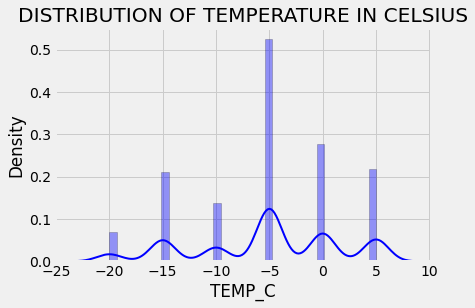

In [ ]:
# CHECKING SOME DISTRIBUTIONS BEFORE ENCODING AND CHANGING DATA
sns.distplot(all_data['TEMP_C'], hist=True, kde=True, 
             bins=int(180/5), color = 'blue', 
             hist_kws={'edgecolor':'black'},
             kde_kws={'linewidth': 2})
plt.title('DISTRIBUTION OF TEMPERATURE IN CELSIUS')

**CHECKING SOME DISTRIBUTIONS HISTROGRAMS**

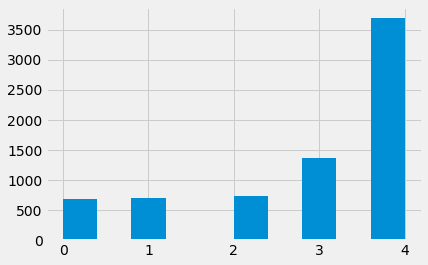

In [ ]:
plt.hist(all_data['WEATHER'])
plt.show()

/usr/local/lib/python3.8/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


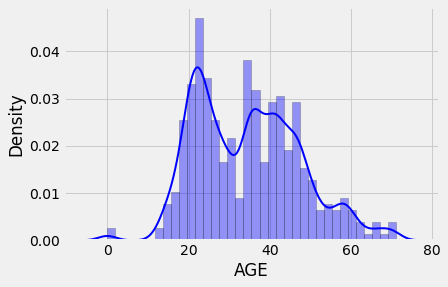

In [ ]:
sns.distplot(all_data['AGE'], hist=True, kde=True, 
             bins=int(180/5), color = 'blue', 
             hist_kws={'edgecolor':'black'},
             kde_kws={'linewidth': 2})

In [ ]:
# FAHRENHEIT CONVERTER - CONVERT AND APPEND TO DB
# df = df.assign(Fahrenheit = lambda x: (9/5)*x['Celsius']+32)

all_data = all_data.assign(TEMP_F = lambda x: (9/5)*x['TEMP_C']+32)
# SHOW ROWS 1 THRU 5 AND COLUMNS 0 THRU 15
all_data.head()

,ID,QUESTIONAIRE_CODE,QUESTION,CODE-QUESTION,QUE_TIME,WEEKDAY,PRICE,PERIOD,WEATHER,TEMP_C,...,INCOME,INCOME_L100,INCOME_100-300,INCOME_300-600,INCOME_600-900,INCOME_900-1200,INCOME_M1200,INCOME_NOANSWER,SKI_INTEREST,TEMP_F
0,1,2,8,2,10,0,250,0,4,-5,...,5.0,0,0,0,0,0,1,0,5.0,23.0
1,1,2,8,2,5,0,350,0,4,-5,...,5.0,0,0,0,0,0,1,0,5.0,23.0
2,1,2,8,2,5,0,450,0,4,-5,...,5.0,0,0,0,0,0,1,0,5.0,23.0
3,1,2,8,2,1,0,550,0,4,-5,...,5.0,0,0,0,0,0,1,0,5.0,23.0
4,1,2,8,2,10,1,250,0,4,-5,...,5.0,0,0,0,0,0,1,0,5.0,23.0


In [ ]:
tempN20c = all_data[(all_data['TEMP_-20C'] ==1)]
#tempN20c.iloc[0:5,30:40] ## this tells me where the 0s turn to 1s, ROW 135
all_data.iloc[130:140, 30:40]

,FOG,TEMP_-20C,TEMP_-15C,TEMP_-10C,TEMP_-5C,TEMP_0C,TEMP_5C,NO_WIND,GENTLE_BREEZE,FRESH_BREEZE
130,0,0,0,0,0,0,1,1,0,0
131,0,0,0,0,0,0,1,1,0,0
132,0,0,0,0,0,0,1,1,0,0
133,0,0,0,0,0,0,1,1,0,0
134,0,0,0,0,0,0,1,1,0,0
135,0,1,0,0,0,0,0,1,0,0
136,0,1,0,0,0,0,0,1,0,0
137,0,1,0,0,0,0,0,1,0,0
138,0,1,0,0,0,0,0,1,0,0
139,0,1,0,0,0,0,0,1,0,0


In [ ]:
all_data['TEMP_F'] = all_data['TEMP_F'].astype('int')
all_data['TEMP_F'].dtype

dtype('int64')

In [ ]:
#MOVE TEMP_F CLOSER TO TEMP C
#col_e = df.pop("e")
#df.insert(3, "e", col_e)
#df
moveTempF = all_data.pop("TEMP_F")
all_data.insert(10, 'TEMP_F', moveTempF)
# SHOW ROWS 1 THRU 5 AND COLUMNS 0 THRU 15
all_data.iloc[0:5, 0:16]

,ID,QUESTIONAIRE_CODE,QUESTION,CODE-QUESTION,QUE_TIME,WEEKDAY,PRICE,PERIOD,WEATHER,TEMP_C,TEMP_F,WIND,SLOPES_OPEN,R8-HELP,RATING,QUE_1
0,1,2,8,2,10,0,250,0,4,-5,23,2,1.0,0,90,0
1,1,2,8,2,5,0,350,0,4,-5,23,2,1.0,1,100,0
2,1,2,8,2,5,0,450,0,4,-5,23,2,1.0,2,20,0
3,1,2,8,2,1,0,550,0,4,-5,23,2,1.0,3,10,1
4,1,2,8,2,10,1,250,0,4,-5,23,2,1.0,4,90,0


In [ ]:
# drop_duplicates

# EDA:
* renamed some columns to be more clear and in relation to temperature
* removed NANs (reviewed and filled with 0)
* recoded object strings
* reviewed outliers in continuous data (AGE, SKIING_DAYS_TOTAL, SKIING_DAYS_HAFJELL) ... will remove outliers later if those variables are under consideration
* reviewed some histograms for distributions on some variables of possible interest (continous variables or those with greater integer variance)
* converted overall temp from C to F

# <font color = 'red'> BUILD NEW FEATURE SET THAT ADDRESSES BEHAVIOR FACTORS</font>

In [ ]:
all_data['ID'].nunique()
# ID column is 400 survey respondents, so like "user ID"

399

In [ ]:
all_data_v2 = all_data.copy()

In [ ]:
all_data_v2.shape

(7182, 88)

In [ ]:
all_data_v2 = all_data_v2.drop_duplicates()

In [ ]:
all_data_v2.shape

## NO DUPES??

(7182, 88)

In [ ]:
weather_list = ['WEATHER',
                'TEMP_C',                
                'WIND',
                'SUN',
                'RAIN',
                'SNOW',
                'CLOUD',
                'FOG',
                'TEMP_-20C',
                'TEMP_-15C',
                'TEMP_-10C',
                'TEMP_-5C',
                'TEMP_0C',
                'TEMP_5C',
                'NO_WIND',
                'GENTLE_BREEZE',
                'FRESH_BREEZE'              
                ]
# REMOVED  'TEMP_F' BC ONLY ONE TEMP MEASURING IS NEEDED AND OTHER TEMPS ARE C

In [ ]:
behaviors_list = ['TEMP_C',                
                'SUN',
                'RAIN',
                'SNOW',
                'CLOUD',
                'FOG',
                'TEMP_-20C',
                'TEMP_-15C',
                'TEMP_-10C',
                'TEMP_-5C',
                'TEMP_0C',
                'TEMP_5C',
                'NO_WIND',
                'GENTLE_BREEZE',
                'FRESH_BREEZE', 
                'QUE_1',
                'QUE_5',
                'QUE_10',
                'REGULAR_WEEK',
                'VACATION',
                'MIDWEEK',
                'WEEKEND',
                'SLOPES_50',
                'SLOPES_75',
                'SLOPES_100',
                'SINGLE',
                'SINGLE_WCHILD',
                'COUPLE',
                'COUPLE_WCHILD',
                'OTHER',
                'DISTANCE',
                'SKI_INTEREST',
                'AGE',
                'MALE',
                'FEMALE',    
]

In [ ]:
behavior_df_orig = all_data_v2[behaviors_list]
behavior_df_orig.head()

,TEMP_C,SUN,RAIN,SNOW,CLOUD,FOG,TEMP_-20C,TEMP_-15C,TEMP_-10C,TEMP_-5C,...,SINGLE,SINGLE_WCHILD,COUPLE,COUPLE_WCHILD,OTHER,DISTANCE,SKI_INTEREST,AGE,MALE,FEMALE
0,-5,1,0,0,0,0,0,0,0,1,...,0,0,0,1,0,0.0,5.0,47.0,0.0,1
1,-5,1,0,0,0,0,0,0,0,1,...,0,0,0,1,0,0.0,5.0,47.0,0.0,1
2,-5,1,0,0,0,0,0,0,0,1,...,0,0,0,1,0,0.0,5.0,47.0,0.0,1
3,-5,1,0,0,0,0,0,0,0,1,...,0,0,0,1,0,0.0,5.0,47.0,0.0,1
4,-5,1,0,0,0,0,0,0,0,1,...,0,0,0,1,0,0.0,5.0,47.0,0.0,1


In [ ]:
behavior_df_orig.shape

(7182, 35)

In [ ]:
# #weather_df  = all_data[['WEATHER','TEMP C','TEMP_F', 'WIND', 'SUN', 'RAIN', 'SNOW',]]
# weather_df_orig = all_data[weather_list]
# weather_df_orig.head()


In [ ]:
# weather_df_orig.shape, weather_df_orig.describe()

In [ ]:
behavior_df_orig

,TEMP_C,SUN,RAIN,SNOW,CLOUD,FOG,TEMP_-20C,TEMP_-15C,TEMP_-10C,TEMP_-5C,...,SINGLE,SINGLE_WCHILD,COUPLE,COUPLE_WCHILD,OTHER,DISTANCE,SKI_INTEREST,AGE,MALE,FEMALE
0,-5,1,0,0,0,0,0,0,0,1,...,0,0,0,1,0,0.0,5.0,47.0,0.0,1
1,-5,1,0,0,0,0,0,0,0,1,...,0,0,0,1,0,0.0,5.0,47.0,0.0,1
2,-5,1,0,0,0,0,0,0,0,1,...,0,0,0,1,0,0.0,5.0,47.0,0.0,1
3,-5,1,0,0,0,0,0,0,0,1,...,0,0,0,1,0,0.0,5.0,47.0,0.0,1
4,-5,1,0,0,0,0,0,0,0,1,...,0,0,0,1,0,0.0,5.0,47.0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7177,-10,0,0,0,1,0,0,0,1,0,...,0,0,1,0,0,15.0,2.0,22.0,1.0,0
7178,-10,0,0,0,1,0,0,0,1,0,...,0,0,1,0,0,15.0,2.0,22.0,1.0,0
7179,-10,0,0,0,1,0,0,0,1,0,...,0,0,1,0,0,15.0,2.0,22.0,1.0,0
7180,-10,0,0,0,1,0,0,0,1,0,...,0,0,1,0,0,15.0,2.0,22.0,1.0,0


CONSIDER SCALING:
* WEATHER
* TEMP_C
* WIND
* distance
* age
* intersest

WILL CONSIDER MINMAX SCALING TO KEEP EVERYTHING BETWEEN 0 AND 1

In [ ]:
behavior_df = behavior_df_orig.copy()

In [ ]:
#wx_df.dtypes
behavior_df.dtypes

TEMP_C             int64
SUN                int64
RAIN               int64
SNOW               int64
CLOUD              int64
FOG                int64
TEMP_-20C          int64
TEMP_-15C          int64
TEMP_-10C          int64
TEMP_-5C           int64
TEMP_0C            int64
TEMP_5C            int64
NO_WIND            int64
GENTLE_BREEZE      int64
FRESH_BREEZE       int64
QUE_1              int64
QUE_5              int64
QUE_10             int64
REGULAR_WEEK       int64
VACATION           int64
MIDWEEK            int64
WEEKEND            int64
SLOPES_50          int64
SLOPES_75          int64
SLOPES_100         int64
SINGLE             int64
SINGLE_WCHILD      int64
COUPLE             int64
COUPLE_WCHILD      int64
OTHER              int64
DISTANCE         float64
SKI_INTEREST     float64
AGE              float64
MALE             float64
FEMALE             int64
dtype: object

In [ ]:
# CONVERTING FLOATS TO INTS

# behavior_df['WIND'] = behavior_df['WIND'].astype('int')
# behavior_df['TEMP_C'] = behavior_df['TEMP_C'].astype('int')
behavior_df['DISTANCE'] = behavior_df['DISTANCE'].astype('int')
behavior_df['SKI_INTEREST'] = behavior_df['SKI_INTEREST'].astype('int')
behavior_df['AGE'] = behavior_df['AGE'].astype('int')
behavior_df['MALE'] = behavior_df['MALE'].astype('int')

In [ ]:
#wx_df.dtypes
behavior_df.dtypes

TEMP_C           int64
SUN              int64
RAIN             int64
SNOW             int64
CLOUD            int64
FOG              int64
TEMP_-20C        int64
TEMP_-15C        int64
TEMP_-10C        int64
TEMP_-5C         int64
TEMP_0C          int64
TEMP_5C          int64
NO_WIND          int64
GENTLE_BREEZE    int64
FRESH_BREEZE     int64
QUE_1            int64
QUE_5            int64
QUE_10           int64
REGULAR_WEEK     int64
VACATION         int64
MIDWEEK          int64
WEEKEND          int64
SLOPES_50        int64
SLOPES_75        int64
SLOPES_100       int64
SINGLE           int64
SINGLE_WCHILD    int64
COUPLE           int64
COUPLE_WCHILD    int64
OTHER            int64
DISTANCE         int64
SKI_INTEREST     int64
AGE              int64
MALE             int64
FEMALE           int64
dtype: object

**CHECKING FOR CORRELATION**

In [ ]:
# wx_df.corr()
behavior_df.corr().round(2)

,TEMP_C,SUN,RAIN,SNOW,CLOUD,FOG,TEMP_-20C,TEMP_-15C,TEMP_-10C,TEMP_-5C,...,SINGLE,SINGLE_WCHILD,COUPLE,COUPLE_WCHILD,OTHER,DISTANCE,SKI_INTEREST,AGE,MALE,FEMALE
TEMP_C,1.00,-0.19,0.50,-0.16,-0.23,0.25,-0.48,-0.59,-0.23,0.02,...,-0.04,-0.02,-0.07,0.11,-0.02,0.09,0.04,0.03,-0.05,0.05
SUN,-0.19,1.00,-0.35,-0.50,-0.33,-0.34,0.22,-0.14,-0.33,0.74,...,0.00,0.12,0.05,-0.06,0.05,-0.03,-0.04,0.04,-0.00,-0.00
RAIN,0.50,-0.35,1.00,-0.16,-0.11,-0.11,-0.08,-0.14,-0.11,-0.26,...,0.06,-0.04,-0.12,0.10,-0.05,0.01,0.08,-0.04,0.01,-0.01
SNOW,-0.16,-0.50,-0.16,1.00,-0.16,-0.16,-0.11,0.48,-0.16,-0.37,...,0.03,-0.06,0.06,-0.07,-0.06,-0.03,0.04,-0.03,0.03,-0.03
CLOUD,-0.23,-0.33,-0.11,-0.16,1.00,-0.11,-0.07,-0.13,1.00,-0.25,...,-0.02,-0.04,-0.02,-0.00,0.02,-0.02,-0.05,-0.04,0.04,-0.04
FOG,0.25,-0.34,-0.11,-0.16,-0.11,1.00,-0.07,-0.14,-0.11,-0.25,...,-0.10,-0.04,-0.02,0.09,0.02,0.09,-0.02,0.05,-0.09,0.09
TEMP_-20C,-0.48,0.22,-0.08,-0.11,-0.07,-0.07,1.00,-0.09,-0.07,-0.17,...,-0.01,0.02,0.04,-0.03,0.01,-0.06,-0.05,0.01,-0.02,0.02
TEMP_-15C,-0.59,-0.14,-0.14,0.48,-0.13,-0.14,-0.09,1.00,-0.13,-0.31,...,0.10,-0.02,0.03,-0.09,-0.03,-0.09,0.04,-0.06,0.06,-0.06
TEMP_-10C,-0.23,-0.33,-0.11,-0.16,1.00,-0.11,-0.07,-0.13,1.00,-0.25,...,-0.02,-0.04,-0.02,-0.00,0.02,-0.02,-0.05,-0.04,0.04,-0.04
TEMP_-5C,0.02,0.74,-0.26,-0.37,-0.25,-0.25,-0.17,-0.31,-0.25,1.00,...,-0.03,0.10,0.03,0.00,0.04,0.04,-0.00,0.04,0.00,-0.01


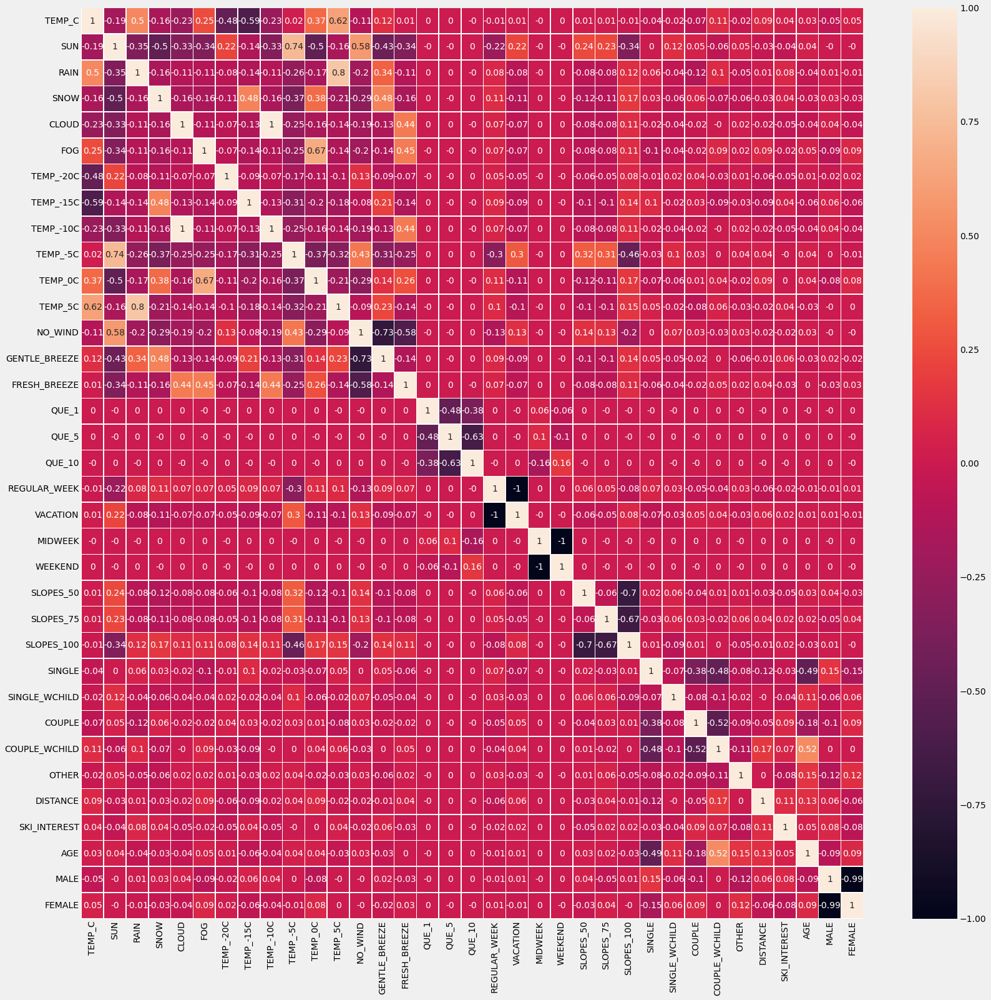

In [ ]:
# fig, ax = plt.subplots(figsize=(15,15))  
# sns.heatmap(wx_df.corr(), annot=True, linewidths=0.5, ax=ax );
fig, ax = plt.subplots(figsize=(25,25))  
sns.heatmap(behavior_df.corr().round(2), annot=True, linewidths=0.5, ax=ax )


POSTIVE CORRELATIONS:
* WIND AND NO_WIND ARE HIGHLY CORRELATED (0.93) \{NO_WIND(1) = WIND("no wind") and GENTLE and FRESH are WIND(0)\} 
* TEMP_5C AND RAIN SIGNIFICANTLY CORRELATED (0.8) - yes there are some rows that reported rain and temp_5c. At that temp = it's not cold enough to snow (41F)  \{\{I will not drop bc they are 2 different kinds of weather, mutually exclusive\}\}
* WEATHER AND SUN SIGNIFICANTLY CORRELATED (0.81) \{same as wind and no wind above. Weather "sun" gets a 1 for SUN and all other weather (cloud, fog etc) got )s\}

CONSIDER DROPPING OR EDITING THESE 

**CAN DROP WIND, TEMP, WEATHER BC OTHER COLUMNS ARE THE ONE-HOT-ENCODES**

Defintely drop:
* wind
* weather

Keep TEMP_C bc those temps are mutually exclusive of other weather one-hot-encoded weather types

In [ ]:
# wx_df= wx_df.drop(['WEATHER', 'WIND'], axis=1)
# # # df.drop(['C', 'D'], axis=1)
# # dropping these seems to mess up the clustering tbh

In [ ]:
#DROPPING CORRELATED/IRRELEVANT VARIABLES
behavior_df= behavior_df.drop(['TEMP_-20C','TEMP_-10C','TEMP_-5C','TEMP_0C','TEMP_5C','TEMP_-15C'], axis=1)

In [ ]:
behavior_df.head()


,TEMP_C,SUN,RAIN,SNOW,CLOUD,FOG,NO_WIND,GENTLE_BREEZE,FRESH_BREEZE,QUE_1,...,SINGLE,SINGLE_WCHILD,COUPLE,COUPLE_WCHILD,OTHER,DISTANCE,SKI_INTEREST,AGE,MALE,FEMALE
0,-5,1,0,0,0,0,1,0,0,0,...,0,0,0,1,0,0,5,47,0,1
1,-5,1,0,0,0,0,1,0,0,0,...,0,0,0,1,0,0,5,47,0,1
2,-5,1,0,0,0,0,1,0,0,0,...,0,0,0,1,0,0,5,47,0,1
3,-5,1,0,0,0,0,1,0,0,1,...,0,0,0,1,0,0,5,47,0,1
4,-5,1,0,0,0,0,1,0,0,0,...,0,0,0,1,0,0,5,47,0,1


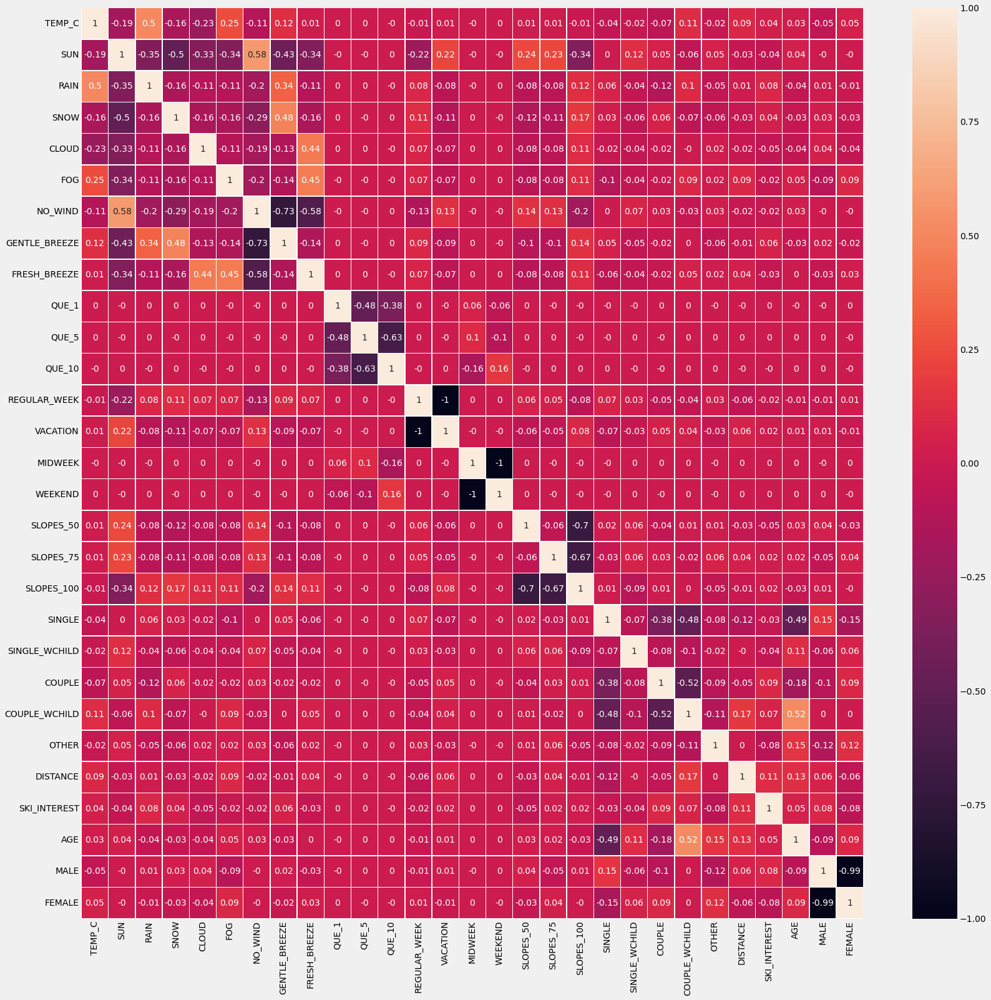

In [ ]:
# fig, ax = plt.subplots(figsize=(15,15))  
# sns.heatmap(wx_df.corr(), annot=True, linewidths=0.5, ax=ax );
fig, ax = plt.subplots(figsize=(25,25))  
sns.heatmap(behavior_df.corr().round(2), annot=True, linewidths=0.5, ax=ax )

**DROPPED SPECIFIC TEMP NUMBERS AND JUST KEPT SUN RAIN SNOW ETC.**

**CORRELATIONS: <BR>
correlations look good. negatives are explanatory. removed the ones that were close to one (temps)**

In [ ]:
behavior_df.shape

(7182, 29)

In [ ]:
# DROPPING DUPES INSIDE behavior_df
behavior_droppeddupes = behavior_df.drop_duplicates()
behavior_droppeddupes.shape

#dropped 2430 rows


(4752, 29)

In [ ]:
behavior_droppeddupes.head()

,TEMP_C,SUN,RAIN,SNOW,CLOUD,FOG,NO_WIND,GENTLE_BREEZE,FRESH_BREEZE,QUE_1,...,SINGLE,SINGLE_WCHILD,COUPLE,COUPLE_WCHILD,OTHER,DISTANCE,SKI_INTEREST,AGE,MALE,FEMALE
0,-5,1,0,0,0,0,1,0,0,0,...,0,0,0,1,0,0,5,47,0,1
1,-5,1,0,0,0,0,1,0,0,0,...,0,0,0,1,0,0,5,47,0,1
3,-5,1,0,0,0,0,1,0,0,1,...,0,0,0,1,0,0,5,47,0,1
4,-5,1,0,0,0,0,1,0,0,0,...,0,0,0,1,0,0,5,47,0,1
6,-5,1,0,0,0,0,1,0,0,0,...,0,0,0,1,0,0,5,47,0,1


# <font color = 'red'>UNSUPERVISED CLUSTERING MODELS</font>

Will start with a random sample of 90% of the data

# <font color = 'blue'> DEFINING X </FONT>

In [ ]:
# TAKING 90% OF ALL DATA
# X = behavior_df.sample(frac = 0.9)
# X.shape

X = behavior_droppeddupes.sample(frac = 0.90)
X.shape

(4277, 29)

In [ ]:
# TAKING 20% OF DATA FOR Y/TARGET IF NEEDED
y = behavior_droppeddupes.sample(frac = 0.10)
y.shape

# 2d, not 1d like most y targets

(475, 29)

In [ ]:
# Standardizing the X data features - scaling from std deviation
scaler = StandardScaler() # again not a minmax scaler here
X_scaled_std= scaler.fit_transform(X)
X_scaled_std

array([[ 1.46612029, -1.02918416,  2.92715436, ...,  2.73478431,
         0.86437291, -0.85942881],
       [-1.42956038, -1.02918416, -0.34162872, ..., -1.2160091 ,
         0.86437291, -0.85942881],
       [-2.15348055,  0.97164341, -0.34162872, ..., -0.05401104,
         0.86437291, -0.85942881],
       ...,
       [-0.70564021, -1.02918416, -0.34162872, ..., -0.5962768 ,
         0.86437291, -0.85942881],
       [-0.70564021, -1.02918416, -0.34162872, ..., -1.52587525,
        -1.15690808,  1.1635635 ],
       [ 0.01827996,  0.97164341, -0.34162872, ...,  0.87558741,
         0.86437291, -0.85942881]])

In [ ]:
# Standardizing the X data features - scaling from std deviation
mmscaler = MinMaxScaler() 
X_scaled_mm = mmscaler.fit_transform(X)
X_scaled_mm

array([[1.        , 0.        , 1.        , ..., 0.98591549, 1.        ,
        0.        ],
       [0.2       , 0.        , 0.        , ..., 0.26760563, 1.        ,
        0.        ],
       [0.        , 1.        , 0.        , ..., 0.47887324, 1.        ,
        0.        ],
       ...,
       [0.4       , 0.        , 0.        , ..., 0.38028169, 1.        ,
        0.        ],
       [0.4       , 0.        , 0.        , ..., 0.21126761, 0.        ,
        1.        ],
       [0.6       , 1.        , 0.        , ..., 0.64788732, 1.        ,
        0.        ]])

In [ ]:
X_scaled_mm.shape

(4277, 29)

**AFTER SEVERAL MODEL RUNS - I DETERMINED THAT MINMAX SCALING PRODUCED BEST RESULTS. WILL WORK WITH MINMAX SCALING FROM HERE FORWARD**

# K-MEANS CLUSTERING

# ELBOW METHOD TO DETERMINE CLUSTER #

In [ ]:
kmeans_kwargs = {
    'init': 'random',
    'n_init': 10,
    'max_iter': 300,
    'random_state': 222,
}

# a list holds the SSE values for each k
sse_mm = []
for k in range(1,11):
  kmeans= KMeans(n_clusters = k, **kmeans_kwargs)
  kmeans.fit(X_scaled_mm)
  sse_mm.append(kmeans.inertia_)

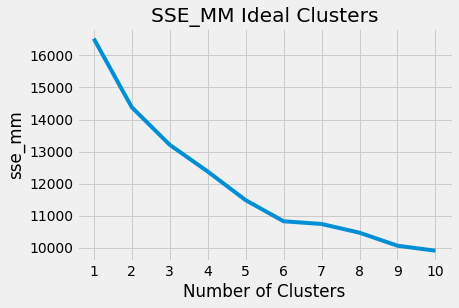

In [ ]:
plt.style.use("fivethirtyeight")
plt.plot(range(1,11), sse_mm)
plt.xticks(range(1,11))
plt.xlabel("Number of Clusters")
plt.ylabel("sse_mm")
plt.title("SSE_MM Ideal Clusters")
plt.show()

In [ ]:
kneelox = KneeLocator(
    range(1,11), sse_mm, curve='convex', direction='decreasing'
)
print("Suggested clusters for MM scaling:",kneelox.elbow)

Suggested clusters for MM scaling: 5


IVE RAN THIS ELBOW SEVERAL TIMES AND MOSTLY IT COMES OUT TO 6 SO I'M STICKING WITH 6

In [ ]:
kmeans5 = KMeans(n_clusters=5, random_state=222, n_init = 10, max_iter=500)

kmeans4 = KMeans(n_clusters=4, random_state=222, n_init = 10)

kmeans6 = KMeans(n_clusters=6, random_state=333, n_init = 10, max_iter = 501)

kmeans8 = KMeans(n_clusters=8, random_state=222, n_init = 10)

In [ ]:
cluster_km_mm = kmeans6.fit_predict(X_scaled_mm)
cluster_km_mm

array([3, 3, 2, ..., 4, 5, 2], dtype=int32)

In [ ]:
## TRYING 4 CLUSTERS TOO FOR MM
cluster_km_mm4 = kmeans4.fit_predict(X_scaled_mm)
cluster_km_mm4

array([3, 3, 0, ..., 3, 1, 0], dtype=int32)

PCA DIMENSIONALITY REDUCTION


In [ ]:
pca_km_mm = PCA(n_components=2).fit_transform(X_scaled_mm)
# pca_km -  2d array
pca_km_mm.shape

(4277, 2)

# KMEANS ON PCA

In [ ]:
# 5 clusters with a model fit to X_scaled_mm that has been PCA'd
cluster5_pcakm_mm = kmeans5.fit_predict(pca_km_mm) 
cluster5_pcakm_mm

array([2, 2, 4, ..., 2, 0, 4], dtype=int32)

In [ ]:
# 6 clusters with a model fit to X_scaled_mm that has been PCA'd
cluster6_pcakm_mm = kmeans6.fit_predict(pca_km_mm) 
cluster6_pcakm_mm

array([1, 1, 0, ..., 1, 5, 0], dtype=int32)

In [ ]:
# 4 CLUSTERS ON MM
cluster4_pcakm_mm = kmeans4.fit_predict(pca_km_mm) 
cluster4_pcakm_mm

array([3, 3, 0, ..., 3, 2, 0], dtype=int32)

In [ ]:
centroids = kmeans.cluster_centers_ ## from elbow defined
centroids6 = kmeans6.cluster_centers_ ## from 6 clusters
#centroids8 = kmeans8.cluster_centers_
# centroids4 = kmeans4.cluster_centers_
#centroids5 = kmeans5.cluster_centers_

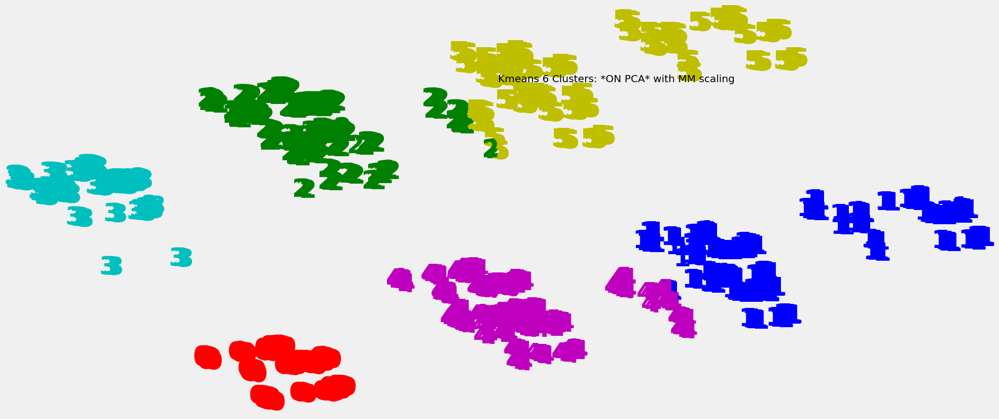

In [ ]:
# PLOT KMEANS DONE ON PCA_KM_MM INSTEAD OF KMEANS ON X_SCALED
plt.figure(figsize=(10,5))
colours = "r","b","g","c","m","y","k","burlywood","chartreuse"
for i in range(pca_km_mm.shape[0]):
    plt.text(pca_km_mm[i, 0], pca_km_mm[i, 1], str(cluster6_pcakm_mm[i]),
             color=colours[cluster6_pcakm_mm[i]],
             fontdict={'weight': 'bold', 'size':50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("Kmeans 6 Clusters: *ON PCA* with MM scaling")
plt.show()

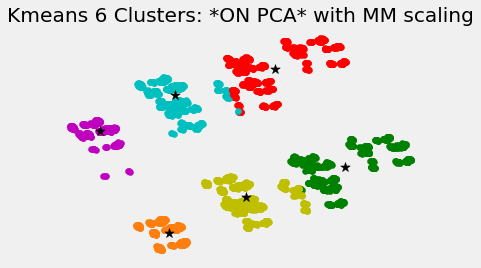

In [ ]:
# SCATTER PLOT DATA WITH COLOR
#plt.figure(figsize=(10,5))
colours = "tab:orange","g","c","m","y",'r',"burlywood","chartreuse", 'k'
for i in range(pca_km_mm.shape[0]):
    plt.scatter(pca_km_mm[i, 0], pca_km_mm[i, 1], color=colours[cluster6_pcakm_mm[i]])
plt.scatter(centroids6[:,0], centroids6[:,1], color = "black",marker = "*", s=100)
plt.xticks([])
plt.yticks([])
#plt.axis('off')
plt.title("Kmeans 6 Clusters: *ON PCA* with MM scaling")
plt.show()

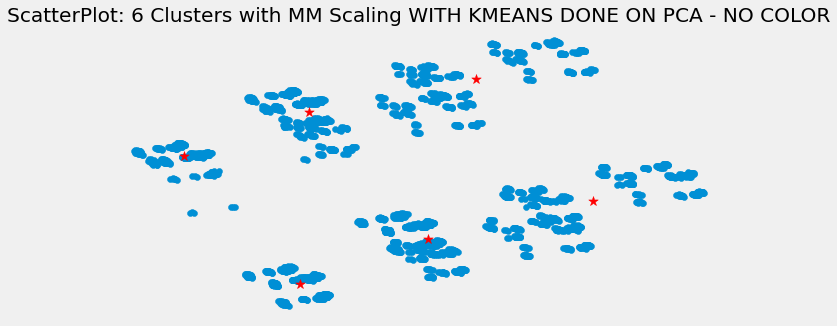

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(pca_km_mm[:, 0], pca_km_mm[:, 1]) #plot every row, value col 1 against every row, value col 2
plt.scatter(centroids6[:,0], centroids6[:,1], color = "red",marker = "*", s=100)
plt.xticks([])
plt.yticks([])
#plt.axis('off')
plt.title("ScatterPlot: 6 Clusters with MM Scaling WITH KMEANS DONE ON PCA - NO COLOR")
plt.show()


**6 CLEARLY DEFINED CLUSTERS WITH KMEANS ON PCA**

In [ ]:
# # SCATTER PLOT DATA WITH COLOR - labels? 
# #plt.figure(figsize=(10,5))

# f, (ax1, ax2) = plt.subplots(1, 2, sharey=True,figsize=(10,6))
# colours = "tab:orange","g","c","m","y",'r',"burlywood","chartreuse", 'k'
# for i in range(pca_km_mm.shape[0]):
#     ax1.scatter(pca_km_mm[i, 0], pca_km_mm[i, 1], color=colours[cluster6_pcakm_mm[i]])
#     ax1.set_title("PCA colors by kmeans6 model")


# #ax1.scatter(centroids_six[:,0], centroids_six[:,1], color = "black",marker = "*", s=100)
# #plt.scatter(data[0][:,0],data[0][:,1],c=kmeans6.labels_,cmap='brg')

# ax2.scatter(pca_km_mm[:,0],pca_km_mm[:,1],c=[kmeans6.labels_])
# ax2.set_title("PCA colors by labels")



# plt.xticks([])
# plt.yticks([])
# plt.axis('off')
# #plt.title("Kmeans 6 Clusters: *ON PCA* with MM scaling")
# plt.show()

<font color='purple'>**SO AT THIS POINT, WE HAVE CLUSTERED INTO 6 CLUSTERS AND ASSIGNED LABELS. THERE ARE 6 UNIQUE LABELS**

Append back to X </font>

In [ ]:
#make labels
kmeans6.labels_

array([1, 1, 0, ..., 1, 5, 0], dtype=int32)

In [ ]:
kmeans6_labels = pd.DataFrame(kmeans6.labels_)
kmeans6_labels['CLUSTER_ID'] = kmeans6_labels
kmeans6_labels.head()

,0,CLUSTER_ID
0,1,1
1,1,1
2,0,0
3,4,4
4,4,4


In [ ]:
kmeans6_labels_df2=kmeans6_labels.drop(kmeans6_labels.columns[0], axis=1)
kmeans6_labels_df2.shape

(4277, 1)

In [ ]:
kmeans6_labels.value_counts().sort_values(ascending=False)

0  CLUSTER_ID
4  4             1024
1  1              796
2  2              725
0  0              628
5  5              627
3  3              477
dtype: int64

In [ ]:
pca_km_df = pd.DataFrame(pca_km_mm)
pca_km_df.head()

,0,1
0,1.438399,0.093060
1,1.413741,0.163702
2,-0.643465,-0.851869
3,-0.057083,-0.452151
4,0.000354,-0.310421


In [ ]:
# concatentate kmeans6_labels to pca_km_mm
clustered_pcakm= pd.concat([pca_km_df, kmeans6_labels_df2], axis=1)
#clustered_pcakm.iloc[100:110]
clustered_pcakm


,0,1,CLUSTER_ID
0,1.438399,0.093060,1
1,1.413741,0.163702,1
2,-0.643465,-0.851869,0
3,-0.057083,-0.452151,4
4,0.000354,-0.310421,4
...,...,...,...
4272,1.113941,0.088737,1
4273,0.959625,-0.320614,1
4274,0.774692,-0.389481,1
4275,0.693739,1.034579,5


In [ ]:
X.reset_index(inplace=True)
X

,index,TEMP_C,SUN,RAIN,SNOW,CLOUD,FOG,NO_WIND,GENTLE_BREEZE,FRESH_BREEZE,...,SINGLE,SINGLE_WCHILD,COUPLE,COUPLE_WCHILD,OTHER,DISTANCE,SKI_INTEREST,AGE,MALE,FEMALE
0,0,5,0,1,0,0,0,0,1,0,...,0,0,0,1,0,0,4,70,1,0
1,1,-15,0,0,1,0,0,0,1,0,...,0,0,1,0,0,50,7,19,1,0
2,2,-20,1,0,0,0,0,1,0,0,...,0,0,1,0,0,65,4,34,1,0
3,3,-5,1,0,0,0,0,1,0,0,...,0,0,0,1,0,700,5,50,1,0
4,4,-5,1,0,0,0,0,1,0,0,...,0,0,1,0,0,0,6,23,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4272,4272,-10,0,0,0,1,0,0,0,1,...,0,0,1,0,0,0,6,25,1,0
4273,4273,0,0,0,1,0,0,1,0,0,...,1,0,0,0,0,15,5,22,1,0
4274,4274,-10,0,0,0,1,0,1,0,0,...,1,0,0,0,0,19,6,27,1,0
4275,4275,-10,0,0,0,1,0,0,0,1,...,1,0,0,0,0,60,6,15,0,1


In [ ]:
X.drop('index', inplace=True, axis=1)
#X.drop('level_0', inplace=True, axis=1)
X

,TEMP_C,SUN,RAIN,SNOW,CLOUD,FOG,NO_WIND,GENTLE_BREEZE,FRESH_BREEZE,QUE_1,...,SINGLE,SINGLE_WCHILD,COUPLE,COUPLE_WCHILD,OTHER,DISTANCE,SKI_INTEREST,AGE,MALE,FEMALE
0,5,0,1,0,0,0,0,1,0,1,...,0,0,0,1,0,0,4,70,1,0
1,-15,0,0,1,0,0,0,1,0,0,...,0,0,1,0,0,50,7,19,1,0
2,-20,1,0,0,0,0,1,0,0,1,...,0,0,1,0,0,65,4,34,1,0
3,-5,1,0,0,0,0,1,0,0,0,...,0,0,0,1,0,700,5,50,1,0
4,-5,1,0,0,0,0,1,0,0,1,...,0,0,1,0,0,0,6,23,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4272,-10,0,0,0,1,0,0,0,1,0,...,0,0,1,0,0,0,6,25,1,0
4273,0,0,0,1,0,0,1,0,0,0,...,1,0,0,0,0,15,5,22,1,0
4274,-10,0,0,0,1,0,1,0,0,0,...,1,0,0,0,0,19,6,27,1,0
4275,-10,0,0,0,1,0,0,0,1,1,...,1,0,0,0,0,60,6,15,0,1


In [ ]:
# X.drop('index', inplace=True, axis=1)
# X.drop('level_0', inplace=True, axis=1)
# X

In [ ]:
clustered_X= pd.concat([X, kmeans6_labels_df2], axis=1)
clustered_X.shape  

# why are there more rows and only col and why is it full of nans now ? because random sample of X  - there were empty rows via index

(4277, 30)

In [ ]:
clustered_X

,TEMP_C,SUN,RAIN,SNOW,CLOUD,FOG,NO_WIND,GENTLE_BREEZE,FRESH_BREEZE,QUE_1,...,SINGLE_WCHILD,COUPLE,COUPLE_WCHILD,OTHER,DISTANCE,SKI_INTEREST,AGE,MALE,FEMALE,CLUSTER_ID
0,5,0,1,0,0,0,0,1,0,1,...,0,0,1,0,0,4,70,1,0,1
1,-15,0,0,1,0,0,0,1,0,0,...,0,1,0,0,50,7,19,1,0,1
2,-20,1,0,0,0,0,1,0,0,1,...,0,1,0,0,65,4,34,1,0,0
3,-5,1,0,0,0,0,1,0,0,0,...,0,0,1,0,700,5,50,1,0,4
4,-5,1,0,0,0,0,1,0,0,1,...,0,1,0,0,0,6,23,1,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4272,-10,0,0,0,1,0,0,0,1,0,...,0,1,0,0,0,6,25,1,0,1
4273,0,0,0,1,0,0,1,0,0,0,...,0,0,0,0,15,5,22,1,0,1
4274,-10,0,0,0,1,0,1,0,0,0,...,0,0,0,0,19,6,27,1,0,1
4275,-10,0,0,0,1,0,0,0,1,1,...,0,0,0,0,60,6,15,0,1,5


<font color='red'>**MAKE CLUSTER PLOTS OF VARS AGAINST VARS AND WHAT CLUSTERS IS ASSINGED TO WHAT**</FONT>

In [ ]:
cluster0 = clustered_X[(clustered_X['CLUSTER_ID'] ==0)]
cluster0

,TEMP_C,SUN,RAIN,SNOW,CLOUD,FOG,NO_WIND,GENTLE_BREEZE,FRESH_BREEZE,QUE_1,...,SINGLE_WCHILD,COUPLE,COUPLE_WCHILD,OTHER,DISTANCE,SKI_INTEREST,AGE,MALE,FEMALE,CLUSTER_ID
2,-20,1,0,0,0,0,1,0,0,1,...,0,1,0,0,65,4,34,1,0,0
18,-20,1,0,0,0,0,1,0,0,0,...,0,1,0,0,65,4,34,1,0,0
20,-15,1,0,0,0,0,1,0,0,0,...,0,0,0,0,0,7,23,1,0,0
23,-15,1,0,0,0,0,1,0,0,0,...,1,0,0,0,2,7,66,1,0,0
28,-20,1,0,0,0,0,1,0,0,0,...,0,0,1,0,0,6,35,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4230,-5,1,0,0,0,0,1,0,0,0,...,0,0,1,0,20,4,44,1,0,0
4256,-5,1,0,0,0,0,1,0,0,0,...,0,0,1,0,300,6,40,1,0,0
4258,-5,1,0,0,0,0,1,0,0,1,...,0,0,1,0,0,6,47,1,0,0
4263,-5,1,0,0,0,0,1,0,0,0,...,0,1,0,0,19,5,23,1,0,0


In [ ]:
cluster1 = clustered_X[(clustered_X['CLUSTER_ID'] ==1)]
#cluster1

In [ ]:
cluster2 = clustered_X[(clustered_X['CLUSTER_ID'] ==2)]
#cluster2

In [ ]:
cluster3 = clustered_X[(clustered_X['CLUSTER_ID'] ==3)]
#cluster3

In [ ]:
cluster4 = clustered_X[(clustered_X['CLUSTER_ID'] ==4)]
#cluster4

In [ ]:
cluster5 = clustered_X[(clustered_X['CLUSTER_ID'] ==5)]
#cluster5

In [ ]:
cluster1['SKI_INTEREST'].value_counts()

7    255
5    166
6    159
4     94
3     62
2     31
0     16
1     13
Name: SKI_INTEREST, dtype: int64

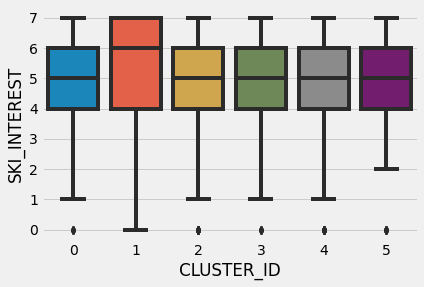

In [ ]:
sns.boxplot(x='CLUSTER_ID', y="SKI_INTEREST", data = clustered_X)

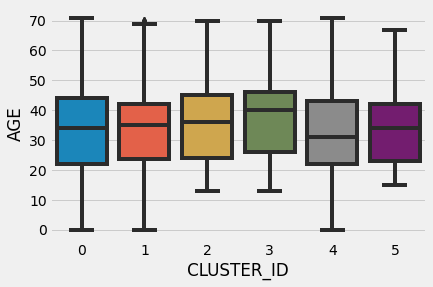

In [ ]:
sns.boxplot(x='CLUSTER_ID', y="AGE", data = clustered_X)

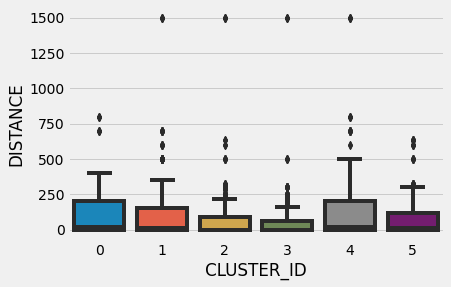

In [ ]:
sns.boxplot(x='CLUSTER_ID', y="DISTANCE", data = clustered_X)

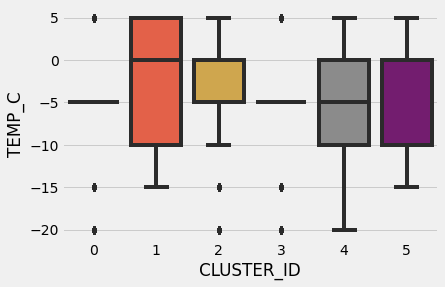

In [ ]:
sns.boxplot(x='CLUSTER_ID', y="TEMP_C", data = clustered_X)

In [ ]:
lgcolors = {'magenta','cyan','yellow','gray','maroon','orange','lime','green','royalblue','darkorchid'}

Text(0.5, 1.0, 'CLUSTER ID WITH MIDWEEK')

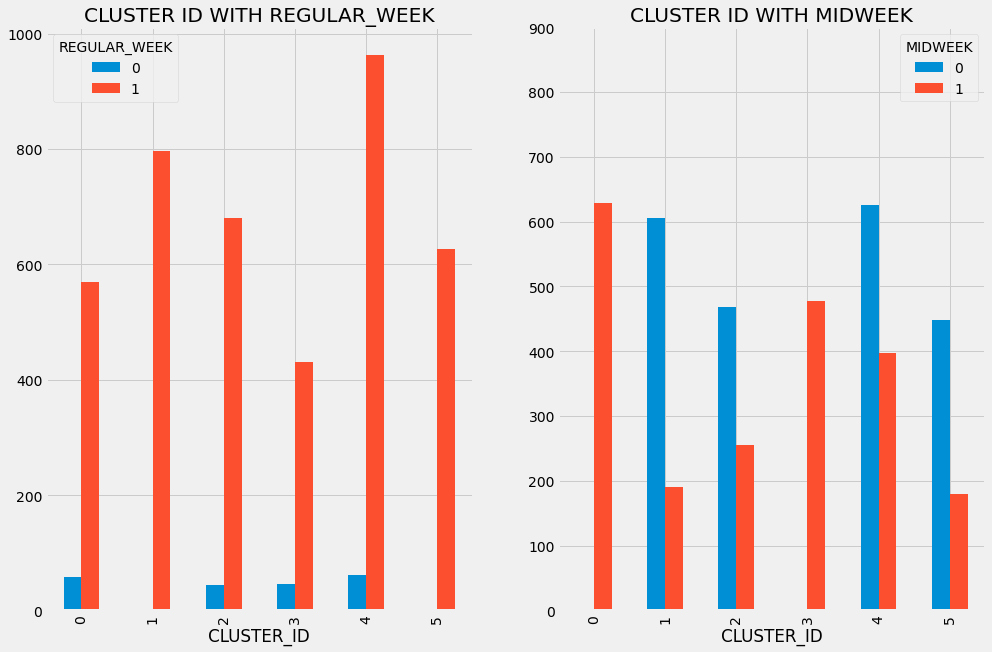

In [ ]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,20))

pd.crosstab(clustered_X['CLUSTER_ID'], clustered_X['REGULAR_WEEK']).plot(kind='bar', ax=ax1,stacked=False, figsize=(15,10))
plt.yticks(np.arange(0.00, 1000, step=100))
ax1.set_title("CLUSTER ID WITH REGULAR_WEEK")

pd.crosstab(clustered_X['CLUSTER_ID'], clustered_X['MIDWEEK']).plot(kind='bar', ax=ax2,stacked=False, figsize=(15,10))
plt.yticks(np.arange(0.00, 1000, step=100))
ax2.set_title("CLUSTER ID WITH MIDWEEK")


Text(0.5, 1.0, 'CLUSTER ID WITH WEEKEND')

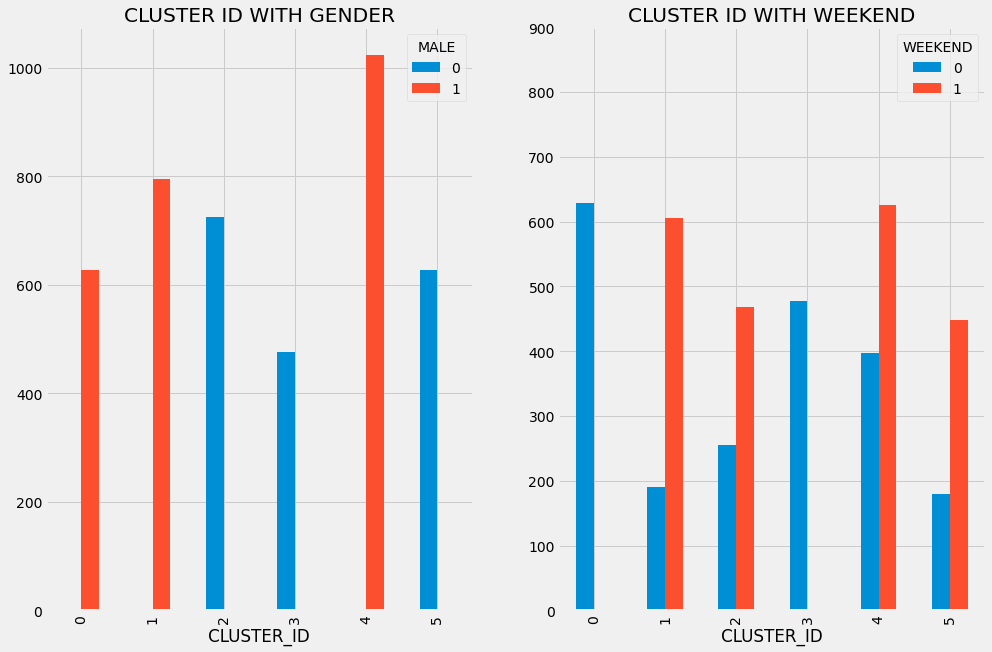

In [ ]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,20))

pd.crosstab(clustered_X['CLUSTER_ID'], clustered_X['MALE']).plot(kind='bar', ax=ax1,stacked=False, figsize=(15,10))
plt.yticks(np.arange(0.00, 1000, step=100))
ax1.set_title("CLUSTER ID WITH GENDER")

pd.crosstab(clustered_X['CLUSTER_ID'], clustered_X['WEEKEND']).plot(kind='bar', ax=ax2,stacked=False, figsize=(15,10))
plt.yticks(np.arange(0.00, 1000, step=100))
ax2.set_title("CLUSTER ID WITH WEEKEND")

Text(0.5, 1.0, 'CLUSTER ID WITH SKI INTEREST')

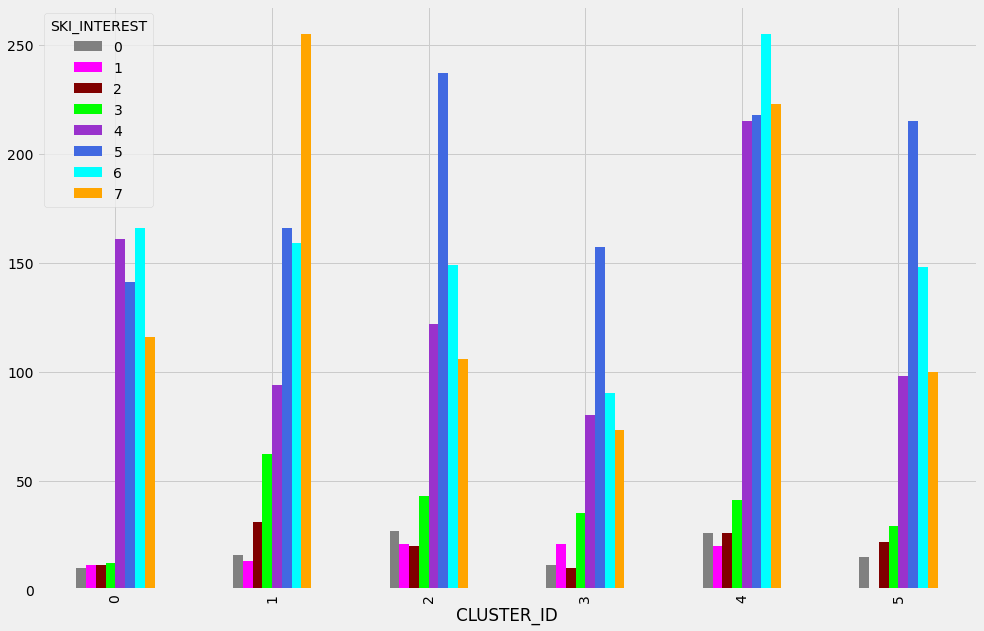

In [ ]:
pd.crosstab(clustered_X['CLUSTER_ID'], clustered_X['SKI_INTEREST'] ).plot(kind='bar',stacked=False, figsize=(15,10), color = lgcolors)
plt.yticks(np.arange(0.00, 300, 50))
ax1.set_title("CLUSTER ID WITH SKI INTEREST")

Text(0.5, 1.0, "CLUSTER ID WITH 'COUPLE WITH CHILD' vs 'SINGLE' vs 'SINGLE WITH CHILD'")

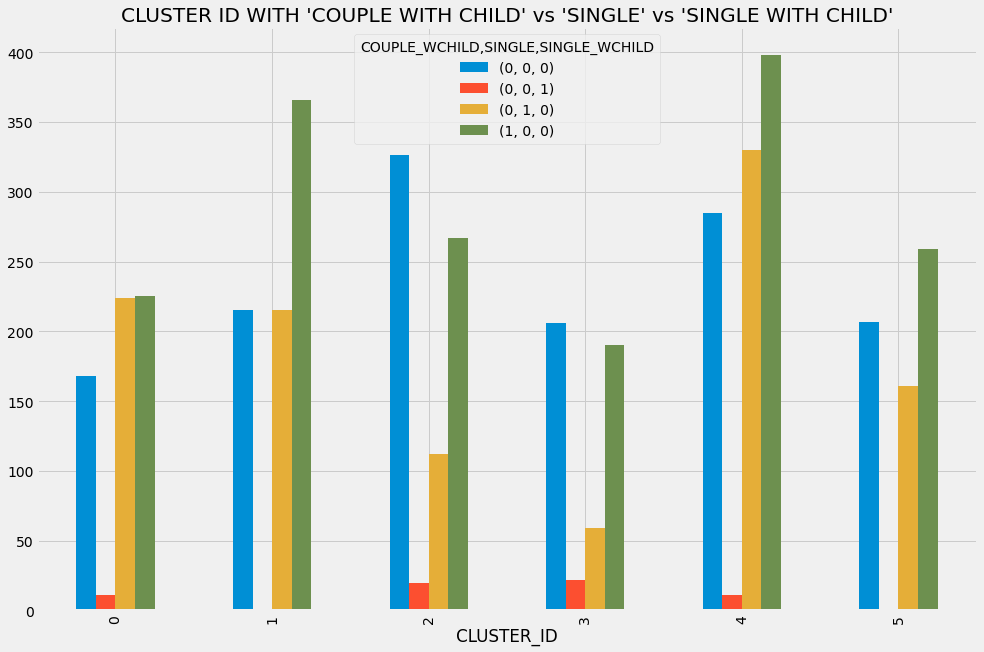

In [ ]:
pd.crosstab(clustered_X['CLUSTER_ID'], [clustered_X['COUPLE_WCHILD'], clustered_X['SINGLE'], clustered_X['SINGLE_WCHILD']]).plot(kind='bar',stacked=False, figsize=(15,10))
plt.yticks(np.arange(0.00,450, 50))
plt.title("CLUSTER ID WITH 'COUPLE WITH CHILD' vs 'SINGLE' vs 'SINGLE WITH CHILD'")

# legend: 0,0 - means 0 for couple_wchild, 0 for single
# 0,0,0 - no couple with child, not single, not SWC - BLUE --> LG: 'SINGLE SOLO SKIERS'
# 0,0,1 - not CWC, not single, yes SWC - ORANGE
# 0,1,0 - no couple with child, yes single, not SWC - YELLOW
# 1,0,0 - couple with child, not single, not SWC - GREEN

Text(0.5, 1.0, 'CLUSTER ID WITH SLOPES OPEN')

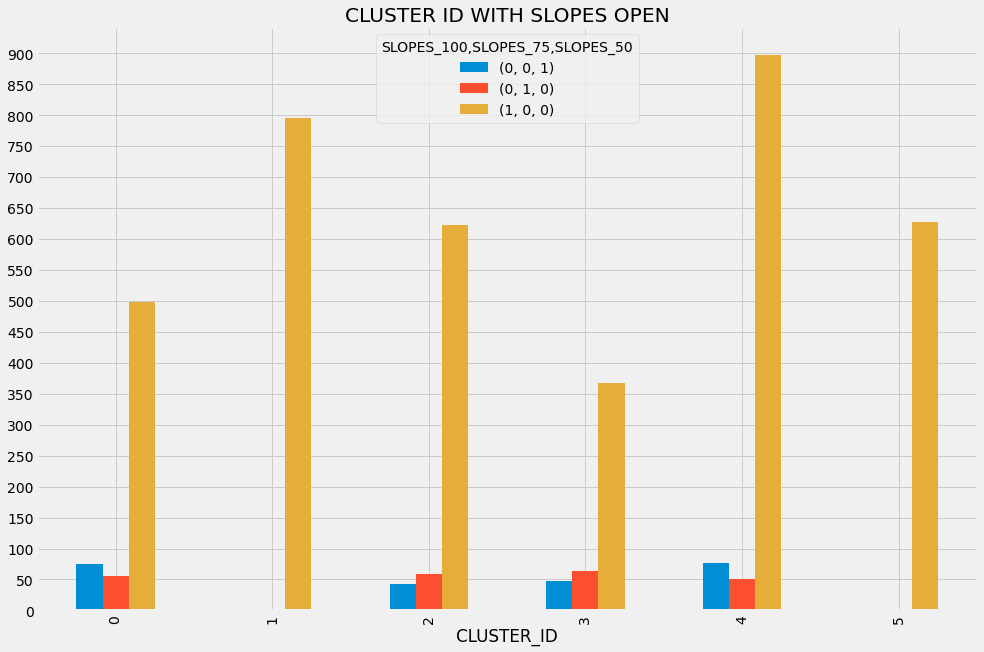

In [ ]:
pd.crosstab(clustered_X['CLUSTER_ID'], [clustered_X['SLOPES_100'], clustered_X['SLOPES_75'], clustered_X['SLOPES_50']]).plot(kind='bar',stacked=False, figsize=(15,10))
plt.yticks(np.arange(0.00,950, 50))
plt.title("CLUSTER ID WITH SLOPES OPEN")


Text(0.5, 1.0, 'CLUSTER ID WITH QUE TIME')

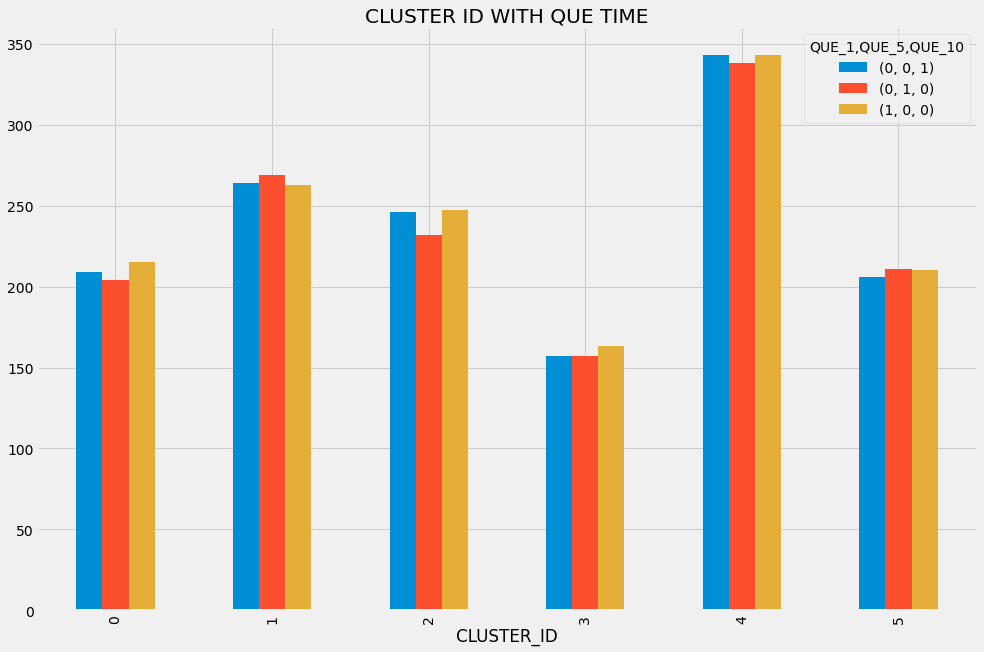

In [ ]:
pd.crosstab(clustered_X['CLUSTER_ID'], [clustered_X['QUE_1'], clustered_X['QUE_5'], clustered_X['QUE_10']]).plot(kind='bar',stacked=False, figsize=(15,10))
plt.yticks(np.arange(0.00,400, 50))
plt.title("CLUSTER ID WITH QUE TIME")

Text(0.5, 1.0, "CLUSTER ID WITH TEMP Celsius #, SNOW, SUN, and 'NO WIND'")

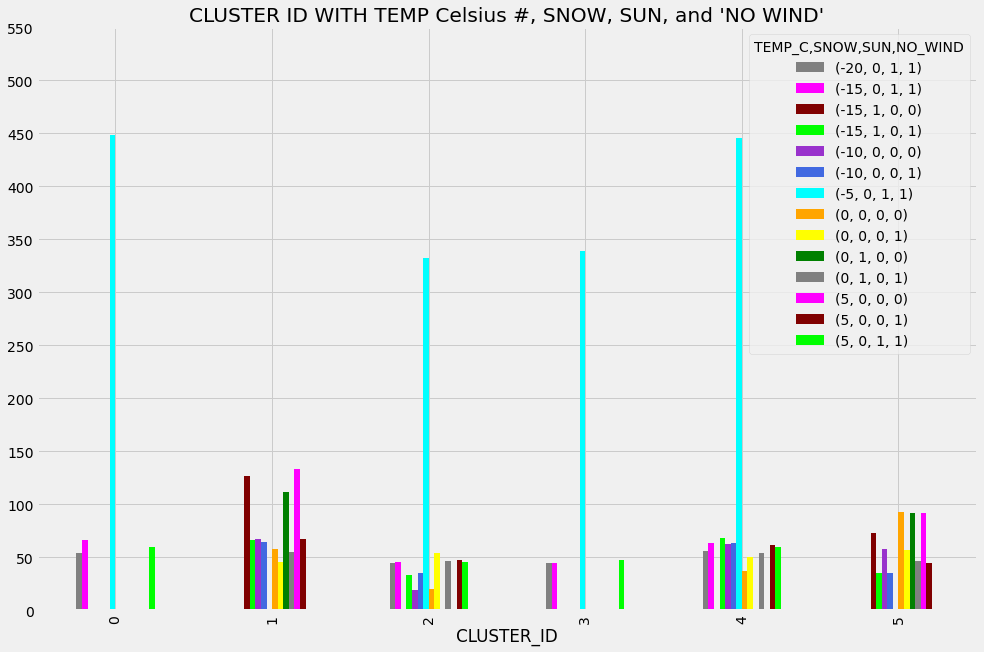

In [ ]:
pd.crosstab(clustered_X['CLUSTER_ID'], [clustered_X['TEMP_C'], clustered_X['SNOW'], clustered_X['SUN'], clustered_X['NO_WIND']]).plot(kind='bar',stacked=False, figsize=(15,10), color=lgcolors)
plt.yticks(np.arange(0.00,600, 50))
plt.title("CLUSTER ID WITH TEMP Celsius #, SNOW, SUN, and 'NO WIND'")

In [ ]:
# GET VALUE COUNTS OF DF CLUSTER0 TO GET AN IDEA OF WHAT VARIABLES HAVE VALUES IN CLUSTER0
for col in cluster0.columns:
  #print(cluster0[col].value_counts())
  ;

In [ ]:
# GET VALUE COUNTS OF DF CLUSTER1 TO GET AN IDEA OF WHAT VARIABLES HAVE VALUES IN CLUSTER0
for col in cluster1.columns:
  #print(cluster1[col].value_counts())
  ;


In [ ]:
# GET VALUE COUNTS OF DF CLUSTER2 TO GET AN IDEA OF WHAT VARIABLES HAVE VALUES IN CLUSTER0
for col in cluster2.columns:
  #print(cluster2[col].value_counts())
  ;


In [ ]:
# GET VALUE COUNTS OF DF CLUSTER3 TO GET AN IDEA OF WHAT VARIABLES HAVE VALUES IN CLUSTER0
for col in cluster3.columns:
  #print(cluster3[col].value_counts())
  ;


In [ ]:
# GET VALUE COUNTS OF DF CLUSTER4 TO GET AN IDEA OF WHAT VARIABLES HAVE VALUES IN CLUSTER0
for col in cluster4.columns:
  #print(cluster4[col].value_counts())
  ;


In [ ]:
# GET VALUE COUNTS OF DF CLUSTER5 TO GET AN IDEA OF WHAT VARIABLES HAVE VALUES IN CLUSTER0
for col in cluster5.columns:
 #print(cluster5[col].value_counts())
 ;


In [ ]:
c0_avgage = cluster0['AGE'].mean()
c0_avgDist = cluster0['DISTANCE'].mean()
c0_avgage, c0_avgDist

(33.62101910828026, 96.55414012738854)

In [ ]:
c1_avgage=cluster1['AGE'].mean()
c1_avgDist = cluster1['DISTANCE'].mean()
c1_avgage, c1_avgDist

(34.36180904522613, 105.7072864321608)

In [ ]:
c2_avgage=cluster2['AGE'].mean()
c2_avgDist = cluster2['DISTANCE'].mean()
c2_avgage, c2_avgDist

(36.22344827586207, 77.5503448275862)

In [ ]:
c3_avgage=cluster3['AGE'].mean()
c3_avgDist = cluster3['DISTANCE'].mean()
c3_avgage, c3_avgDist

(37.509433962264154, 72.17610062893081)

In [ ]:
c4_avgage=cluster4['AGE'].mean()
c4_avgDist = cluster4['DISTANCE'].mean()
c4_avgage, c4_avgDist

(33.5029296875, 104.697265625)

In [ ]:
c5_avgage=cluster5['AGE'].mean()
c5_avgDist = cluster5['DISTANCE'].mean()
c5_avgage, c5_avgDist

(34.24720893141946, 89.7846889952153)

In [ ]:
clustered_X_avgage = clustered_X['AGE'].mean()
clustered_X_avgage

34.69721767594108

In [ ]:
cluster_ages = {i: np.mean(clustered_X["AGE"][clustered_X['CLUSTER_ID'] == i]) for i in np.unique(clustered_X['CLUSTER_ID'])}

In [ ]:
cluster_ids = list(cluster_ages.keys())
average_ages = list(cluster_ages.values())

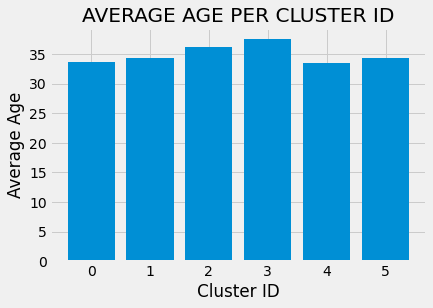

In [ ]:
plt.bar(cluster_ids, average_ages)
plt.xlabel("Cluster ID")
plt.ylabel("Average Age")
plt.title("AVERAGE AGE PER CLUSTER ID")
plt.show()

In [ ]:
c0_avgage,c1_avgage,c2_avgage,c3_avgage,c4_avgage,c5_avgage

(33.62101910828026,
 34.36180904522613,
 36.22344827586207,
 37.509433962264154,
 33.5029296875,
 34.24720893141946)

In [ ]:
cluster_distances = {i: np.mean(clustered_X["DISTANCE"][clustered_X['CLUSTER_ID'] == i]) for i in np.unique(clustered_X['CLUSTER_ID'])}

In [ ]:
cluster_ids = list(cluster_distances.keys())
average_dist = list(cluster_distances.values())

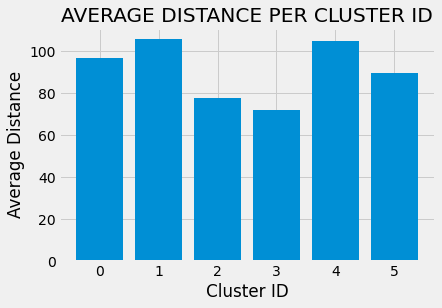

In [ ]:
plt.bar(cluster_ids, average_dist)
plt.xlabel("Cluster ID")
plt.ylabel("Average Distance")
plt.title("AVERAGE DISTANCE PER CLUSTER ID")
plt.show()

In [ ]:
c0_avgDist, c1_avgDist, c2_avgDist, c3_avgDist, c4_avgDist, c5_avgDist

(96.55414012738854,
 105.7072864321608,
 77.5503448275862,
 72.17610062893081,
 104.697265625,
 89.7846889952153)

In [ ]:
# BOX PLOTS AROSS ALL COLS AND CLUSTER_ID
# NOT USING THIS NOW
# numerical = clustered_X.select_dtypes(int).columns
# for col in numerical:
#   plt.figure(figsize=(10,10))
#   sns.boxplot( y=col, x= clustered_X['CLUSTER_ID'], data=clustered_X)
#   plt.show();




---



---



---



In [ ]:
km_sil_pca_mm5 = metrics.silhouette_score(pca_km_mm, cluster5_pcakm_mm, metric='euclidean')
km_sil_pca_mm5

0.5897795054622726

In [ ]:
km_sil_pca_mm6 = metrics.silhouette_score(pca_km_mm, cluster6_pcakm_mm, metric='euclidean')
km_sil_pca_mm6

0.6151122400425725

In [ ]:
km_sil_pca_mm4 = metrics.silhouette_score(pca_km_mm, cluster4_pcakm_mm, metric='euclidean')
km_sil_pca_mm4

0.5659174243094549

<font color = 'blue'>**MINMAX SCALING VERSION OF PCA WITH KMEANS HAS A HIGHER SILHOUETTE SCORE THAN STANDARD SCALING AS WELL**</font>

# TSNE WITH KMEANS

In [ ]:
#TSNE 

#TSNE DIMENSIONALITY REDUCTION
tsne_km = TSNE(n_components=2, verbose=1, perplexity=20, n_iter=300)
tsne_km_mm = tsne_km.fit_transform(X_scaled_mm) ## not using PCA version bc this is a diff version of dimensionality reduction

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 4277 samples in 0.000s...
[t-SNE] Computed neighbors for 4277 samples in 0.605s...
[t-SNE] Computed conditional probabilities for sample 1000 / 4277
[t-SNE] Computed conditional probabilities for sample 2000 / 4277
[t-SNE] Computed conditional probabilities for sample 3000 / 4277
[t-SNE] Computed conditional probabilities for sample 4000 / 4277
[t-SNE] Computed conditional probabilities for sample 4277 / 4277
[t-SNE] Mean sigma: 0.405719
[t-SNE] KL divergence after 250 iterations with early exaggeration: 74.526070
[t-SNE] KL divergence after 300 iterations: 1.664232


In [ ]:
# 6 clusters with a model fit to X_scaled_mm that has been TSNE'd
cluster6_tsnekm_mm = kmeans6.fit_predict(tsne_km_mm) 
cluster6_tsnekm_mm

array([2, 2, 4, ..., 3, 5, 0], dtype=int32)

In [ ]:
## fix the cluster model name
plt.figure(figsize=(10,5))
colours = "r","b","g","c","m","y","k","burlywood","chartreuse"
for i in range(tsne_km_mm.shape[0]):
    plt.text(tsne_km_mm[i, 0], tsne_km_mm[i, 1], str(cluster6_tsnekm_mm[i]),
             color=colours[cluster6_tsnekm_mm[i]],
             #color='red',
             fontdict={'weight': 'bold', 'size': 100}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("KMEANS 6 clusters:TSNE MinMax Scaled")
plt.show()

VERY SCATTERED. CAN ONLY TELL CLUSTERS BY COLORS. NO DEFINED '6 CLUSTERS'

In [ ]:
centroids6 = kmeans6.cluster_centers_
#centroids5 = kmeans5.cluster_centers_

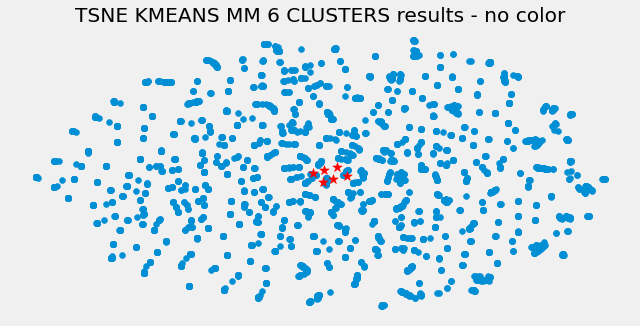

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(tsne_km_mm[:, 0], tsne_km_mm[:, 1])
plt.scatter(centroids6[:,0], centroids6[:,1], color = "red",marker = "*", s=100)
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("TSNE KMEANS MM 6 CLUSTERS results - no color")
plt.show()

NO DEFINED CLUSTERS WITH "NO COLOR", WITH TSNE, SHOULD BE 6 DEFINED CLUSTERS

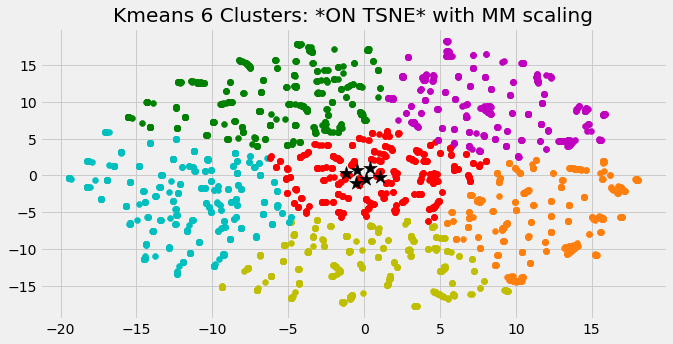

In [ ]:
# SCATTER PLOT DATA WITH COLOR
plt.figure(figsize=(10,5))
colours = "tab:orange","g","c","m","y",'r',"burlywood","chartreuse", 'k'
for i in range(tsne_km_mm.shape[0]):
    plt.scatter(tsne_km_mm[i, 0], tsne_km_mm[i, 1], color=colours[cluster6_tsnekm_mm[i]])
plt.scatter(centroids6[:,0], centroids6[:,1], color = "black",marker = "*", s=200)
# plt.xticks([])
# plt.yticks([])
# plt.axis('off')
plt.title("Kmeans 6 Clusters: *ON TSNE* with MM scaling")
plt.show()

CAN SEE CLUSTERS WITH COLOR BUT THE CLUSTERS ARE VERY CLOSE TO THEIR NEIGHBORS, NOT A GOOD CLUSTERING DEFINITION. 

WON'T USE TSNE DIMENSIONAL REDUCTION



---
# UMAP WITH KMEANS


In [ ]:
umap_km_mm = umap.UMAP(n_neighbors=5,
                      min_dist=0.3,
                      metric='correlation').fit_transform(X_scaled_mm) 
## CREATING NEW DIMENSIONAL REDUCTION ON SCALED DATA

In [ ]:
# FIT THE KMEANS MODEL THE UMAP REDUCTION
# 6 clusters with a model fit to X_scaled_mm that has been UMAP'd
cluster6_umapkm_mm = kmeans6.fit_predict(umap_km_mm) 
cluster6_umapkm_mm

array([5, 2, 4, ..., 1, 0, 3], dtype=int32)

In [ ]:
# PLOT THE NEW REDUCTION TO MODEL DEFINED ABOVE (KMEANS ON UMAP VERSION)
plt.figure(figsize=(10,5))
colours = "r","b","g","c","m","y","k","burlywood","chartreuse", 'tab:orange'
for i in range(umap_km_mm.shape[0]):
    plt.text(umap_km_mm[i, 0], umap_km_mm[i, 1], str(cluster6_umapkm_mm[i]),
             color=colours[cluster6_umapkm_mm[i]],
             #color='red',
             fontdict={'weight': 'bold', 'size': 100}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("KMEANS clusters: 6 CLUSTERS WITH UMAP REDUCTION")
plt.show()

LOOKS VERY SIMILAR TO TSNE. NO CLEARLY DEFINED CLUSTERS 

In [ ]:
#centroids5= kmeans5.cluster_centers_
centroids6= kmeans6.cluster_centers_

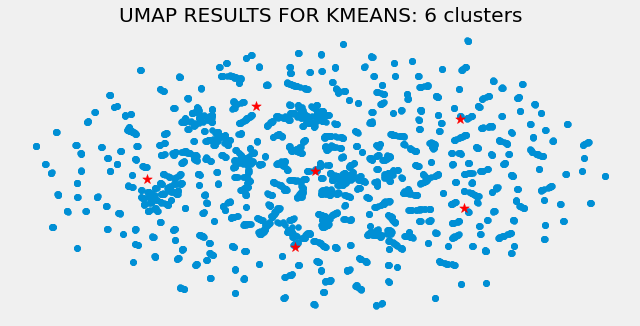

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(umap_km_mm[:, 0], umap_km_mm[:, 1])
plt.scatter(centroids6[:,0], centroids6[:,1], color = "red",marker = "*", s=100)
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("UMAP RESULTS FOR KMEANS: 6 clusters")
plt.show()

NO CLUSTER DEFINITION, EVEN WITH CENTROIDS INDICATED

# SILHOUETTE SCORE
Using SILHOUETTE score because there is no defined y or defined target to measure against


In [ ]:
print("KMEANS 6 clusters PCA Silhouette Score : {}"
      .format(metrics.silhouette_score(pca_km_mm,cluster6_pcakm_mm, metric='euclidean')))
pca_km_mm_sil = metrics.silhouette_score(pca_km_mm,cluster6_pcakm_mm, metric='euclidean')
# pca_km_mm_sil

KMEANS 6 clusters PCA Silhouette Score : 0.6151122400425725


In [ ]:
print("KMEANS 6 clusters TSNE Silhouette Score : {}"
      .format(metrics.silhouette_score(tsne_km_mm, cluster6_tsnekm_mm, metric='euclidean')))

tsne_km_mm_sil = metrics.silhouette_score(tsne_km_mm,cluster6_tsnekm_mm, metric='euclidean')

KMEANS 6 clusters TSNE Silhouette Score : 0.3680615723133087


In [ ]:
print("KMEANS 6 clusters UMAP Silhouette Score : {}"
      .format(metrics.silhouette_score(umap_km_mm, cluster6_umapkm_mm, metric='euclidean')))

umap_km_mm_sil = metrics.silhouette_score(umap_km_mm,cluster6_umapkm_mm, metric='euclidean')

KMEANS 6 clusters UMAP Silhouette Score : 0.36005672812461853


<font color='red'>**FOR THE MINMAX SCALED DATASET - PCA WITH 5 KMEANS CLUSTERS PERFORMED BEST FOR SILHOUETTE SCORE**



---

# <font color='blue'>AGGLOMERATIVE CLUSTERING</font>

In [ ]:
from scipy.cluster.hierarchy import dendrogram, linkage
import sys
sys.setrecursionlimit(100000)

RUNNING A DENDROGRAM TO GET AN IDEA OF BOTTOM UP AGGLOMERATIVE CLUSTERS  - AND GET AN IDEAL CLUSTER NUMBER TO WORK WITH

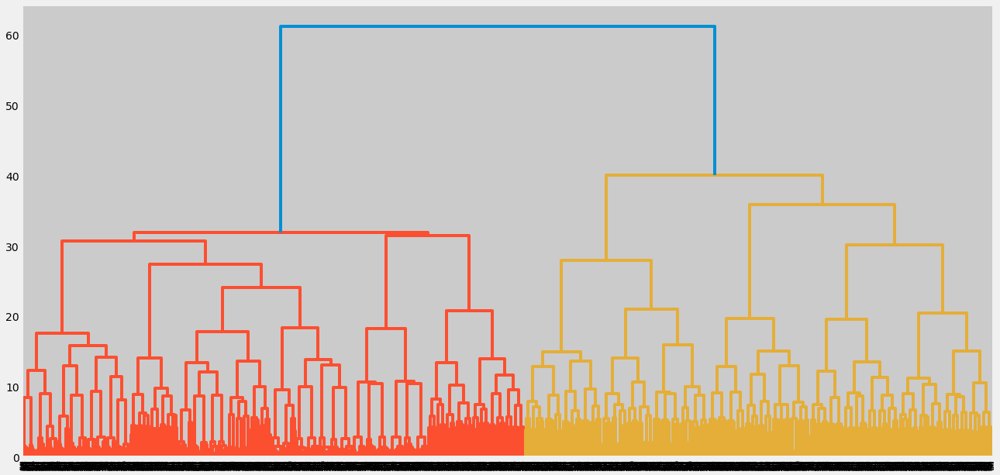

In [ ]:
# running on MM x_scaled
plt.figure(figsize=(20,10))
dendrogram(linkage(X_scaled_mm, method='ward'))
plt.show()



THIS DENDROGRAM IS SHOWING 2 BEST CLUSTERS WITH WARD. 

Complete, average, and single produced uneven clusters distributions

In [ ]:
# Defining the agglomerative clustering - 2 CLUSTERS WITH WARD LINKAGE

agg_cluster_w = AgglomerativeClustering(linkage='ward', n_clusters = 2,
                                     affinity='euclidean'
                                     )

# Fit model on JUST orig x_scaled_mm
clusters2_agg_w = agg_cluster_w.fit_predict(X_scaled_mm) #y_preds


DO PCA FOR AGG CLUSTERING

In [ ]:
pca_agg_mm = PCA(n_components=2).fit_transform(X_scaled_mm)
# THIS BECOMES THE *NEW* X_scaled_mm

In [ ]:
# THIS IS THE 2-CLUSTER WARD MODEL FIT TO THE NEW PCA_AGG
cluster2_pca_agg = agg_cluster_w.fit_predict(pca_agg_mm)

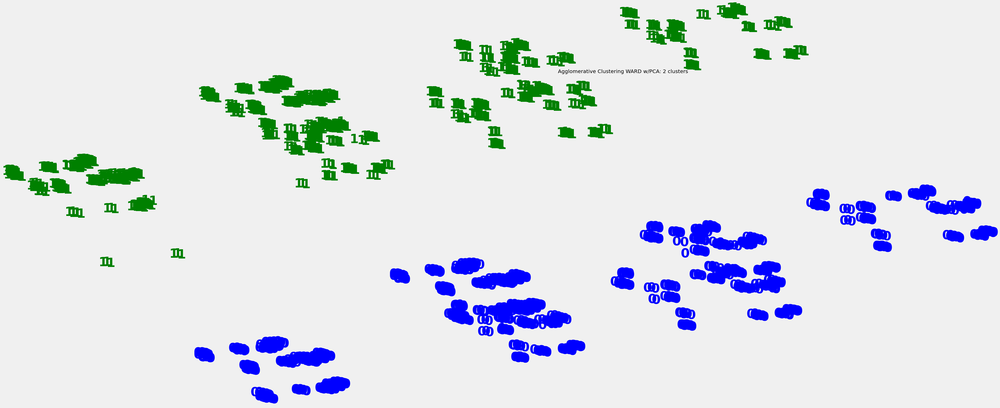

In [ ]:
plt.figure(figsize=(20,10))
colours = "b","g","c","m","y","k",'tab:orange',"burlywood","chartreuse","r"
for i in range(pca_agg_mm.shape[0]):
    plt.text(pca_agg_mm[i, 0], pca_agg_mm[i, 1], str(cluster2_pca_agg[i]), # [i,0] and [i,1] are referencing the 2 pca components
             color=colours[cluster2_pca_agg[i]], #this was just y - is clusters_agg correct here?
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("Agglomerative Clustering WARD w/PCA: 2 clusters")
plt.show()

LOOKS SIMILAR TO KMEANS (BUT WITH 2 CLUSTERS INSTEAD). Separation seems to be vertical and not horizontal

In [ ]:
# FIND CENTROIDS IN AGG CLUSTERING
from sklearn.neighbors import NearestCentroid

clf = NearestCentroid()
clf.fit(pca_agg_mm, cluster2_pca_agg)
print(clf.centroids_)
centroids2 = clf.centroids_

[[ 0.26625581 -0.5318156 ]
 [-0.35636644  0.7118013 ]]


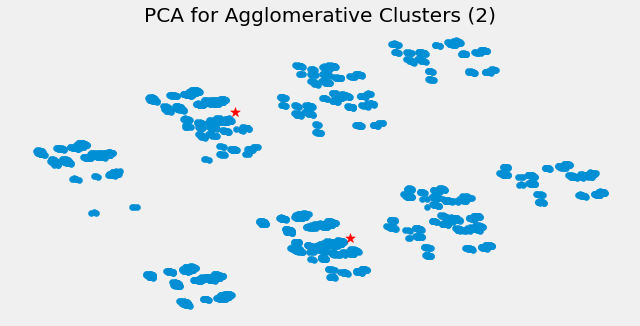

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(pca_agg_mm[:, 0], pca_agg_mm[:, 1])
plt.scatter(centroids2[:,0], centroids2[:,1], color = "red",marker = "*", s=100)
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("PCA for Agglomerative Clusters (2)")
plt.show()

SIMILAR AGAIN TO KMEANS BUT HARD TO SEE WHERE 2 CLUSTERS ARE DEFINED

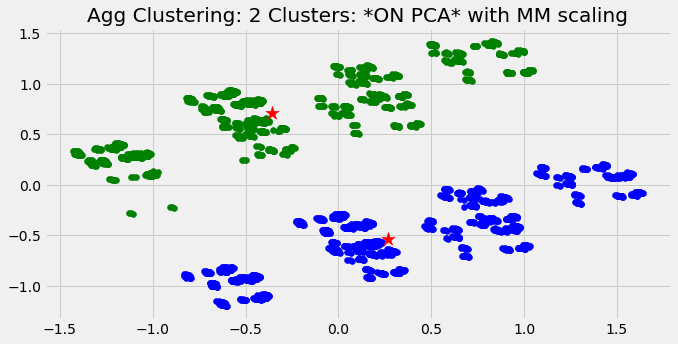

In [ ]:
# SCATTER PLOT DATA WITH COLOR
plt.figure(figsize=(10,5))
colours = "b","g","c","m","y",'r',"burlywood","chartreuse", 'k'
for i in range(pca_agg_mm.shape[0]):
    plt.scatter(pca_agg_mm[i, 0], pca_agg_mm[i, 1], color=colours[cluster2_pca_agg[i]])
plt.scatter(centroids2[:,0], centroids2[:,1], color = "red",marker = "*", s=200)
# plt.xticks([])
# plt.yticks([])
# plt.axis('off')
plt.title("Agg Clustering: 2 Clusters: *ON PCA* with MM scaling")
plt.show()

In [ ]:
agg_sil_w= metrics.silhouette_score(pca_agg_mm,cluster2_pca_agg, metric='euclidean')
agg_sil_w

0.48835903382310886

**PCA AGG CLUSTER SILHOUETTE SCORE IS A TAD LOWER THAN KMEANS**


#TSNE for AGG CLUSTERING

In [ ]:
#TSNE REDUCTION
tsne_agg = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_agg_mm = tsne_agg.fit_transform(X_scaled_mm)


/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 4277 samples in 0.000s...
[t-SNE] Computed neighbors for 4277 samples in 0.581s...
[t-SNE] Computed conditional probabilities for sample 1000 / 4277
[t-SNE] Computed conditional probabilities for sample 2000 / 4277
[t-SNE] Computed conditional probabilities for sample 3000 / 4277
[t-SNE] Computed conditional probabilities for sample 4000 / 4277
[t-SNE] Computed conditional probabilities for sample 4277 / 4277
[t-SNE] Mean sigma: 0.671820
[t-SNE] KL divergence after 250 iterations with early exaggeration: 77.051666
[t-SNE] KL divergence after 300 iterations: 1.443756


In [ ]:
# DO AGG CLUSTERING ON TSNE - have to fit to the original agg cluster model object of "agg_cluster_w"
cluster2_tsne_agg = agg_cluster_w.fit_predict(tsne_agg_mm)

In [ ]:
fig.set_size_inches(12, 8)
colours = "r","b","g","c","m","y","k","tab:orange","burlywood","chartreuse"
for i in range(tsne_agg_mm.shape[0]):
    plt.text(tsne_agg_mm[i, 0], tsne_agg_mm[i, 1], str(cluster2_tsne_agg[i]), # [i,0] and [i,1] are referencing the 2 pca components
             color=colours[cluster2_tsne_agg[i]], #this was just y - is clusters_agg correct here?
             fontdict={'weight': 'bold', 'size': 100}
         )
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("Agglomerative Clustering: Ward with 2 clusters and TSNE")
plt.show()


2 CLUSTERS DEFINED BY COLOR BUT NO DISTINGUISHABLE BOUNDARIES BETWEEN CLUSTERS

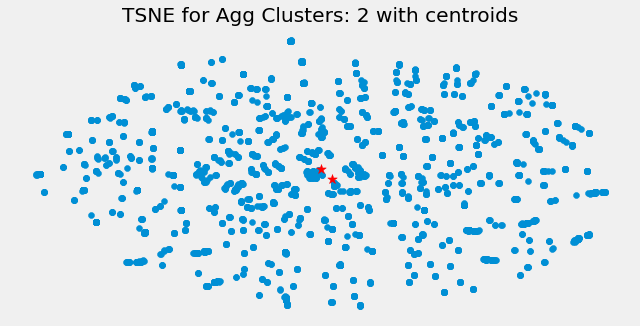

In [ ]:
# SCATTER PLOT FOR TSNE AGG CLUSTERING with TSNE
plt.figure(figsize=(10,5))
plt.scatter(tsne_agg_mm[:, 0], tsne_agg_mm[:, 1])
plt.scatter(centroids2[:,0], centroids2[:,1], color = "red",marker = "*", s=100)
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("TSNE for Agg Clusters: 2 with centroids")
plt.show()


NO CLEARLY DEFINED 2 CLUSTERS. CAN'T SEE ANYTHING EVEN WITH CENTROIDS

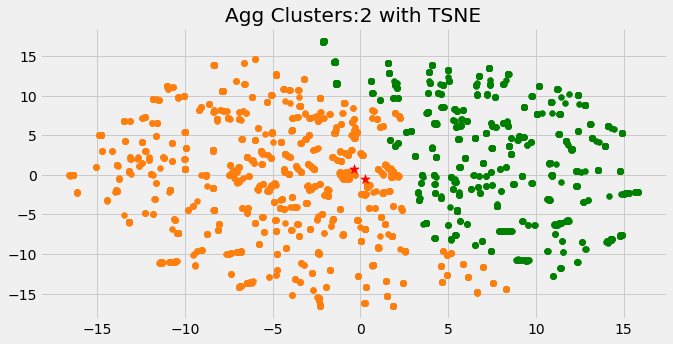

In [ ]:
# SCATTER PLOT DATA WITH COLOR
plt.figure(figsize=(10,5))
colours = "tab:orange","g","c","m","y",'r',"burlywood","chartreuse", 'k'
for i in range(tsne_agg_mm.shape[0]):
    plt.scatter(tsne_agg_mm[i, 0], tsne_agg_mm[i, 1], color=colours[cluster2_tsne_agg[i]])
plt.scatter(centroids2[:,0], centroids2[:,1], color = "red",marker = "*", s=100)
# plt.xticks([])
# plt.yticks([])
# plt.axis('off')
plt.title("Agg Clusters:2 with TSNE")
plt.show()

EVEN WITH COLOR  - CLUSTERS ARE VERY CLOSE TO EACH OTHER AND NO CLEAR DEFINITION BETWEEN THEM.

TSNE DIMENSIONALITY REDUCTION IS NOT A GOOD OPTION TO CONSIDER

In [ ]:
agg_sil_pca= metrics.silhouette_score(pca_agg_mm,cluster2_pca_agg, metric='euclidean')
agg_sil_pca



0.48835903382310886

In [ ]:
agg_sil_tsne= metrics.silhouette_score(tsne_agg_mm,cluster2_tsne_agg, metric='euclidean')
agg_sil_tsne


0.3197805

# UMAP WITH AGGLOMERATIVE CLUSTERING

In [ ]:
#UMAP REDUCTION
umap_agg_mm= umap.UMAP(n_neighbors=5,
                      min_dist=0.3,
                      metric='correlation').fit_transform(X_scaled_mm)
                      
# creating a new "x_scaled_mm" with dimensions reduced

In [ ]:
# FIT THE AGG CLUSTER MODEL THE UMAP REDUCTION
cluster2_umap_agg = agg_cluster_w.fit_predict(umap_agg_mm) 
cluster2_umap_agg


array([0, 0, 0, ..., 0, 0, 1])

In [ ]:
plt.figure(figsize=(10,5))
colours = "r","b","g","c","m","y","k","burlywood","chartreuse"
for i in range(umap_agg_mm.shape[0]):
    plt.text(umap_agg_mm[i, 0], umap_agg_mm[i, 1], str(cluster2_umap_agg[i]),
             color=colours[cluster2_umap_agg[i]],
             fontdict={'weight': 'bold', 'size': 100}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("Agg Clusters Ward: 2 CLUSTERS WITH UMAP")
plt.show()

AGAIN, LOOKS VERY SIMILAR TO TSNE, NO DEFINED "2 CLUSTERS" 


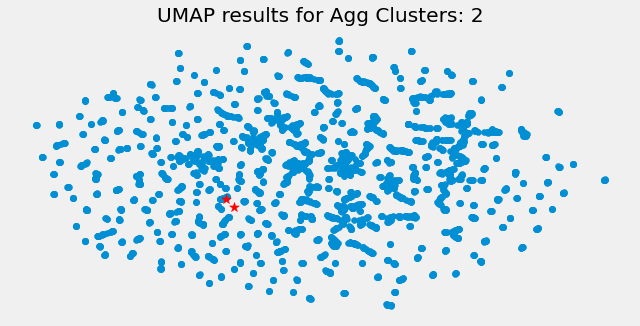

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(umap_agg_mm[:, 0], umap_agg_mm[:, 1])
plt.scatter(centroids2[:,0], centroids2[:,1], color='red', s=100, marker="*")
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("UMAP results for Agg Clusters: 2")
plt.show()

DEFINITELY NOT 2 DEFINED CLUSTERS

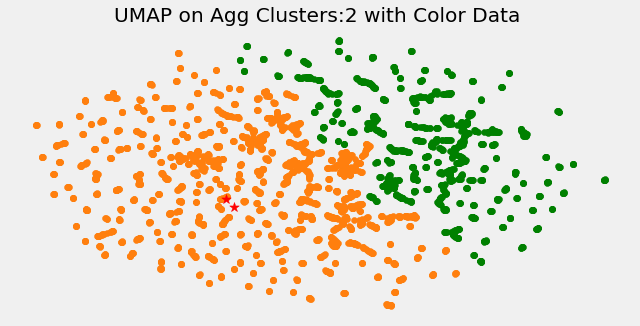

In [ ]:
# SCATTER PLOT DATA WITH COLOR
plt.figure(figsize=(10,5))
colours = "tab:orange","g","c","m","y",'r',"burlywood","chartreuse", 'k'
for i in range(umap_agg_mm.shape[0]):
    plt.scatter(umap_agg_mm[i, 0], umap_agg_mm[i, 1], color=colours[cluster2_umap_agg[i]])
plt.scatter(centroids2[:,0], centroids2[:,1], color = "red",marker = "*", s=100)
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("UMAP on Agg Clusters:2 with Color Data ")
plt.show()

DEFINITLEY NOT 2 DEFINED CLUSTERS HERE.

In [ ]:
agg_sil_pca= metrics.silhouette_score(pca_agg_mm,cluster2_pca_agg, metric='euclidean')
agg_sil_pca

0.48835903382310886

In [ ]:
agg_sil_tsne= metrics.silhouette_score(tsne_agg_mm,cluster2_tsne_agg, metric='euclidean')
agg_sil_tsne

0.3197805

In [ ]:
agg_sil_umap= metrics.silhouette_score(umap_agg_mm,cluster2_umap_agg, metric='euclidean')
agg_sil_umap

0.31372893

<font color='blue'>**WILL STICK WITH PCA FOR AGG CLUSTERING FOR BOTH VISUALATIONS AND SILHOUETTE SCORE WHICH DID BETTER THAN TSNE AND UMAP SCORES** (but not as well as KMEANS)</font>



---

#<font color='red'>DBSCAN</font>

In [ ]:
# DETERMINE BEST CLUSTER AMOUNTS WITH THIS FORMULA
min_samples_list = range(1,11)

for i in range(1,11):
    dbscan_cluster = DBSCAN(eps=0.10, min_samples=i, metric="euclidean") #1.415
    # Fit model
    clusters_pred = dbscan_cluster.fit_predict(X_scaled_mm) #FITTING TO "x", NOT REDUCED
    print("Number of clusters when eps=0.10 and min_samples={} is: {}".format(i, len(np.unique(clusters_pred))))

Number of clusters when eps=0.10 and min_samples=1 is: 3362
Number of clusters when eps=0.10 and min_samples=2 is: 595
Number of clusters when eps=0.10 and min_samples=3 is: 185
Number of clusters when eps=0.10 and min_samples=4 is: 51
Number of clusters when eps=0.10 and min_samples=5 is: 26
Number of clusters when eps=0.10 and min_samples=6 is: 11
Number of clusters when eps=0.10 and min_samples=7 is: 6
Number of clusters when eps=0.10 and min_samples=8 is: 4
Number of clusters when eps=0.10 and min_samples=9 is: 1
Number of clusters when eps=0.10 and min_samples=10 is: 1


In [ ]:
# Defining the Clustering = LOOKING FOR AROUND 5-6-7 CLUSTERS
#dbscan_cluster = DBSCAN(eps=1.415, min_samples=7, metric="euclidean") #model is defined

dbscan_cluster = DBSCAN(eps=0.10, min_samples=7, metric="euclidean") #model is defined

# Fit model
#cluster2_dbscan_e14s7 = dbscan_cluster.fit_predict(X_scaled_mm)  ## fitting to raw x_scaled_mm whole dataset

## LOOKING FOR AROUND 5-6-7 CLUSTERS

In [ ]:
# DOING PCA ON X_scaled_mm TO READY FOR DBSCAN
pca_dbscan  = PCA(n_components=2).fit_transform(X_scaled_mm) #condensing 29 colums down to 2
pca_dbscan.shape

(4277, 2)

In [ ]:
# FIT MODEL TO "NEW X_SCALED_MM" OF pca_dbscan
cluster6_pca_db = dbscan_cluster.fit_predict(pca_dbscan)
cluster6_pca_db.shape

(4277,)

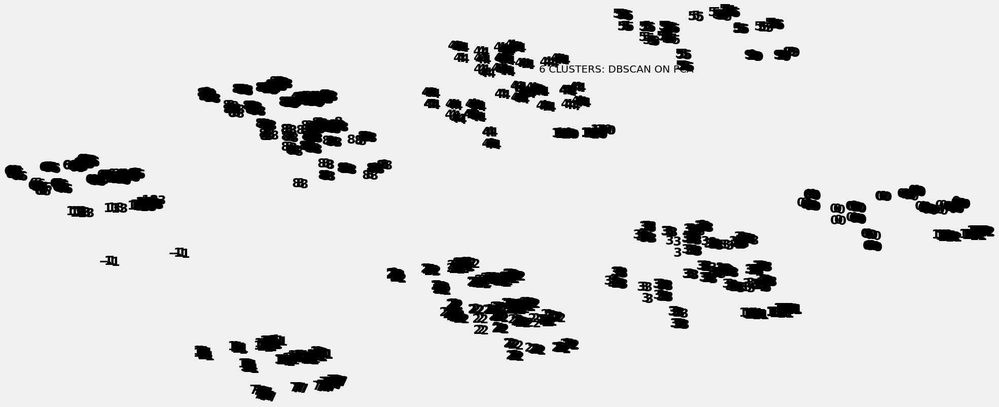

In [ ]:
plt.figure(figsize=(10,5))
colours = ('red','blue','black','yellow','orange','green','purple','cyan','magenta','tab:purple','tab:orange')

for i in range(pca_dbscan.shape[0]):
    plt.text(pca_dbscan[i, 0], pca_dbscan[i, 1], str(cluster6_pca_db[i]),
            #color=colours[cluster6_pcakm_mm[i]],
            # color = colours[cluster6_pca_db[i]], 
            fontdict={'weight': 'bold', 'size': 25}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("6 CLUSTERS: DBSCAN ON PCA")
plt.show()

8 DEFINED CLUSTERS BY COLOR, NOT 6 AS CODED

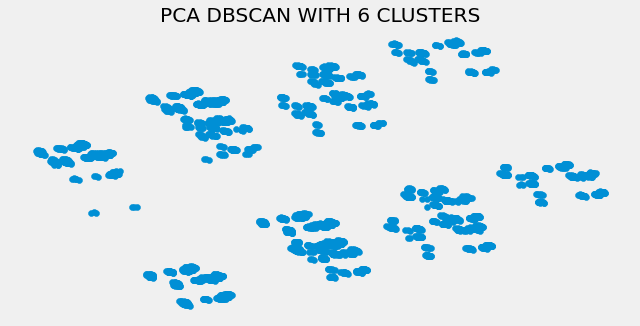

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(pca_dbscan[:, 0], pca_dbscan[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("PCA DBSCAN WITH 6 CLUSTERS")
plt.show()

8 DEFINED CLUSTERS, NOT 6 AS CODED

In [ ]:
dbscan_sil_pca = metrics.silhouette_score(pca_dbscan, cluster6_pca_db, metric='euclidean')
dbscan_sil_pca

0.5028479272718308

**PCA DBSCAN SCORE IS LOWER THAN KMEANS PCA**

# TSNE WITH DBSCAN

In [ ]:
tsne_dbscan = TSNE(n_components=2, verbose=1, perplexity=20, n_iter=300)
tsne_dbscan_mm = tsne_dbscan.fit_transform(X_scaled_mm)

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 4277 samples in 0.002s...
[t-SNE] Computed neighbors for 4277 samples in 0.554s...
[t-SNE] Computed conditional probabilities for sample 1000 / 4277
[t-SNE] Computed conditional probabilities for sample 2000 / 4277
[t-SNE] Computed conditional probabilities for sample 3000 / 4277
[t-SNE] Computed conditional probabilities for sample 4000 / 4277
[t-SNE] Computed conditional probabilities for sample 4277 / 4277
[t-SNE] Mean sigma: 0.405719
[t-SNE] KL divergence after 250 iterations with early exaggeration: 74.564766
[t-SNE] KL divergence after 300 iterations: 1.666126


In [ ]:
#FIT TSNE REDUCTION TO MODEL
cluster6_tsne_dbscan = dbscan_cluster.fit_predict(tsne_dbscan_mm) 
cluster6_tsne_dbscan.shape

(4277,)

In [ ]:
plt.figure(figsize=(10,5))
colours = ('red','blue','black','yellow','orange','green','purple','cyan','magenta','tab:purple','tab:orange')

for i in range(tsne_dbscan_mm.shape[0]):
    plt.text(tsne_dbscan_mm[i, 0], tsne_dbscan_mm[i, 1], str(cluster6_tsne_dbscan[i]),
            # color=colours[cluster6_tsne_dbscan[i]],
            fontdict={'weight': 'bold', 'size': 25}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("6 CLUSTERS: DBSCAN ON PCA")
plt.show()

NO CLEAR DEFINITION OF 6 CLUSTERS. EVEN WITHOUT COLOR.

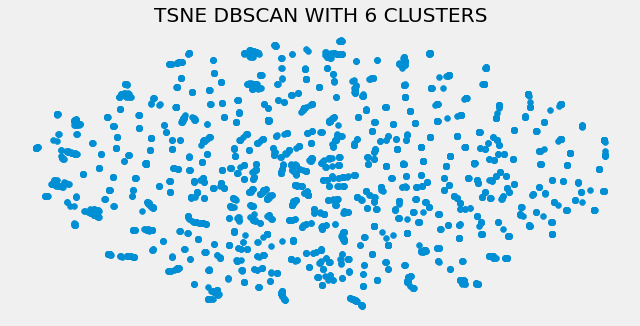

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(tsne_dbscan_mm[:, 0], tsne_dbscan_mm[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("TSNE DBSCAN WITH 6 CLUSTERS") 
plt.show()

STILL NO CLEAR DEFINTION OF 6 CLUSTERS. 

In [ ]:
dbscan_sil_tsne = metrics.silhouette_score(tsne_dbscan_mm, cluster6_tsne_dbscan, metric='euclidean')
dbscan_sil_tsne

0.4002878

**TSNE DBSCAN STILL LOWER THAN KMEANS PCA and PCA DBSCAN**

# UMAP FOR DBSCAN

In [ ]:
#UMAP REDUCTION
umap_dbscan_mm = umap.UMAP(n_neighbors=5,
                      min_dist=0.3,
                      metric='correlation').fit_transform(X_scaled_mm)
                      
#min_dist was 0.3

In [ ]:
# FIT THE MODEL TO THE UMAP REDUCTION
cluster6_umap_dbscan = dbscan_cluster.fit_predict(umap_dbscan_mm) 

In [ ]:
plt.figure(figsize=(10,5))
colours = "r","b","g","c","m","y","k","r","burlywood","chartreuse"
for i in range(umap_dbscan_mm.shape[0]):
    plt.text(umap_dbscan_mm[i, 0], umap_dbscan_mm[i, 1], str(cluster6_umap_dbscan[i]),
            #color=colours[cluster6_umap_dbscan[i]],
             fontdict={'weight': 'bold', 'size': 35}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("DBSCAN WITH UMAP: 6 clusters")
plt.show()

DEFINITELY NOT 6 CLUSTERS.
CANNOT USE COLOR - DON'T HAVE 4000 COLORS TO CYCLE THROUGH

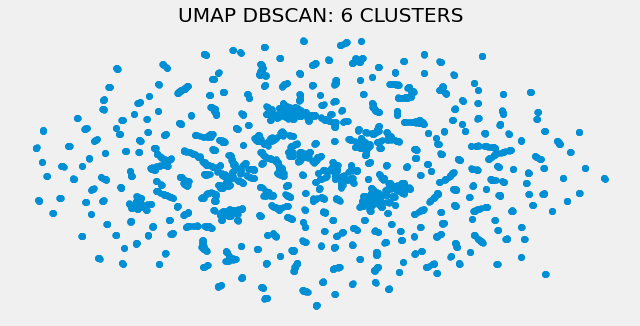

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(umap_dbscan_mm[:, 0], umap_dbscan_mm[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("UMAP DBSCAN: 6 CLUSTERS")
plt.show()

**UMAP NOT PRODUCING 6 DEFINED CLUSTERS**



In [ ]:
dbscan_sil_umap = metrics.silhouette_score(umap_dbscan_mm, cluster6_umap_dbscan, metric='euclidean')
dbscan_sil_umap

-0.1149932

In [ ]:
dbscan_sil_pca, dbscan_sil_tsne, dbscan_sil_umap

(0.5028479272718308, 0.4002878, -0.1149932)

NEGATIVE SILHOUETTE SCORE = NOT GOOD



---

# GMM GAUSSIAN

"components" is like defining clusters. Since previous pre-determinations (elbow and dendrogram) indicated 6 clusters, I will choose 6 components.

In [ ]:
# Defining the GMM model object
gmm_cluster = GaussianMixture(n_components=6, random_state=123, covariance_type="full")

# # Fit model
# clusters_gmm_6 = gmm_cluster.fit_predict(X_scaled_mm)
# cluster6_gmm = gmm_cluster.fit_predict(X_scaled_mm)

In [ ]:
# #GMM TIED
gmm_cluster_tied = GaussianMixture(n_components=6, random_state=123, covariance_type="tied")

# GOING TO USE THIS MODEL AS IT PRODUCED HIGHEST SIL SCORE

In [ ]:
# # Defining the agglomerative clustering
gmm_cluster_diag = GaussianMixture(n_components=6, random_state=123, covariance_type="diag")


In [ ]:
# # GMM Spherical
gmm_cluster_spherical = GaussianMixture(n_components=6, random_state=123, covariance_type="spherical")

In [ ]:
pca_gmm = PCA(n_components=2).fit_transform(X_scaled_mm)

In [ ]:
# FIT THE MODEL OBJECT TO THE PCA VERSION
cluster6_pca_gmm_f = gmm_cluster.fit_predict(pca_gmm)

In [ ]:
cluster6_pca_gmm_t = gmm_cluster_tied.fit_predict(pca_gmm)

In [ ]:
cluster6_pca_gmm_d = gmm_cluster_diag.fit_predict(pca_gmm)

In [ ]:
cluster6_pca_gmm_s = gmm_cluster_spherical.fit_predict(pca_gmm)

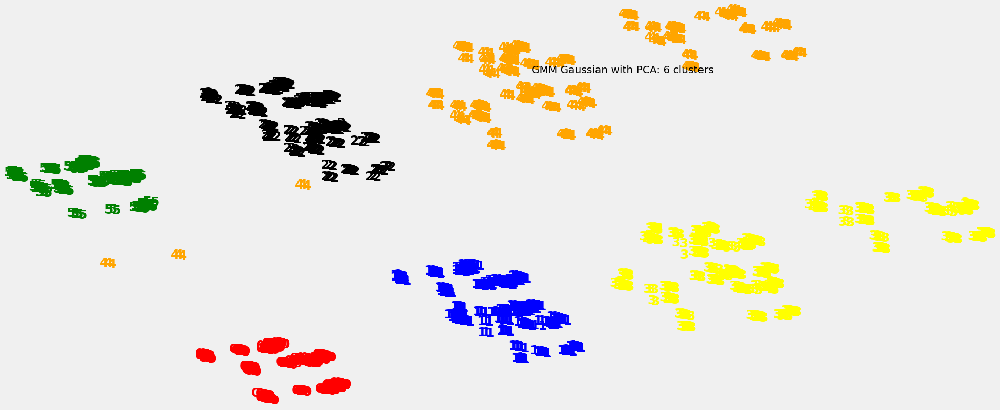

In [ ]:
plt.figure(figsize=(10,5))
colours = ('red','blue','black','yellow','orange','green','purple','cyan','magenta','tab:purple','tab:orange')
for i in range(pca_gmm.shape[0]):
    plt.text(pca_gmm[i, 0], pca_gmm[i, 1], str(cluster6_pca_gmm_f[i]),
            c = colours[cluster6_pca_gmm_f[i]],
             fontdict={'weight': 'bold', 'size': 25}
        )

plt.xticks([])
plt.yticks([])
plt.title("GMM Gaussian with PCA: 6 clusters")
plt.axis('off')
plt.show()

**GMM PCA WITH 6 DISTINCT COLORS but more like 11 clusters**

In [ ]:
import scipy.stats
from sklearn import mixture 
# for making CENTERS in GMM
gmm_cluster_cnt= mixture.GaussianMixture(n_components=6, covariance_type='full').fit(pca_gmm) 
## CLUSTER CENTERS ONLY WORK WITH FULL, NOT 'TIED'

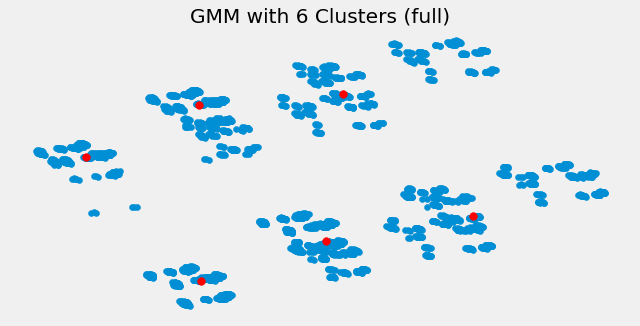

In [ ]:
#gmm_cluster_cnt= mixture.GaussianMixture(n_components=6, covariance_type='full').fit(pca_gmm) 
centers = np.empty(shape=(gmm_cluster_cnt.n_components, pca_gmm.shape[1]))

for i in range(gmm_cluster_cnt.n_components):
    density = scipy.stats.multivariate_normal(cov=gmm_cluster_cnt.covariances_[i], mean=gmm_cluster_cnt.means_[i]).logpdf(pca_gmm)
    centers[i, :] = pca_gmm[np.argmax(density)]

plt.figure(figsize=(10,5))
plt.scatter(pca_gmm[:, 0], pca_gmm[:, 1])
plt.scatter(centers[:, 0], centers[:, 1], s=60, color='red')
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("GMM with 6 Clusters (full)")
plt.show()

6 CENTROIDS FOR WHAT COULD BE 6 CLUSTERS

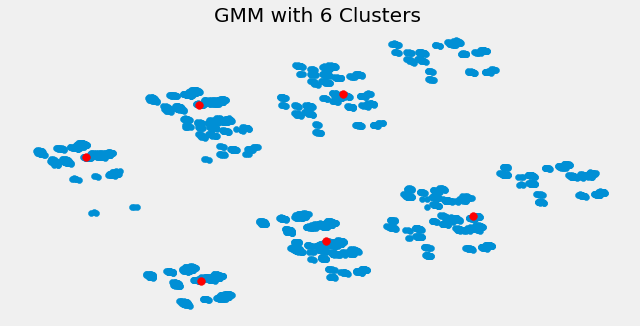

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(pca_gmm[:, 0], pca_gmm[:, 1])
plt.scatter(centers[:, 0], centers[:, 1], s=60, color='red')
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("GMM with 6 Clusters ")
plt.show()

**PCA GMM SCATTER PLOTS SHOWING 6 (or 8?) CLUSTERS AS WELL**

In [ ]:
gmm_sil_pca_full = metrics.silhouette_score(pca_gmm,cluster6_pca_gmm_f, metric='euclidean')
gmm_sil_pca_full

0.6149342823529133

In [ ]:
gmm_sil_tied = metrics.silhouette_score(pca_gmm, cluster6_pca_gmm_t, metric='euclidean')
gmm_sil_tied

0.61391359196327

In [ ]:
gmm_sil_diag = metrics.silhouette_score(pca_gmm, cluster6_pca_gmm_d, metric='euclidean')
gmm_sil_diag

0.6187478214731994

In [ ]:
gmm_sil_spherical = metrics.silhouette_score(pca_gmm, cluster6_pca_gmm_s, metric='euclidean')
gmm_sil_spherical

0.618895726256608

<font color = 'blue'>**WOULD GO WITH GMM PCA SPHERICAL FOR BEST SILHOUETTE SCORE**</font>

# TSNE WITH GMM

In [ ]:
#TSNE REDUCTION
tsne_gmm= TSNE(n_components=2, verbose=1, perplexity=20, n_iter=300)
tsne_gmm_mm = tsne_gmm.fit_transform(X_scaled_mm)

/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:780: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/usr/local/lib/python3.8/dist-packages/sklearn/manifold/_t_sne.py:790: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 4277 samples in 0.000s...
[t-SNE] Computed neighbors for 4277 samples in 0.576s...
[t-SNE] Computed conditional probabilities for sample 1000 / 4277
[t-SNE] Computed conditional probabilities for sample 2000 / 4277
[t-SNE] Computed conditional probabilities for sample 3000 / 4277
[t-SNE] Computed conditional probabilities for sample 4000 / 4277
[t-SNE] Computed conditional probabilities for sample 4277 / 4277
[t-SNE] Mean sigma: 0.405719
[t-SNE] KL divergence after 250 iterations with early exaggeration: 74.896942
[t-SNE] KL divergence after 300 iterations: 1.671368


In [ ]:
# FIT MODEL TO TSNE
cluster6_tsne_gmm = gmm_cluster.fit_predict(tsne_gmm_mm)

In [ ]:
fig.set_size_inches(12, 8)
#plt.figure(figsize=(20,5))
colours = "r","b","g","c","m","y","k","r","burlywood","chartreuse"
for i in range(tsne_gmm_mm.shape[0]):
    plt.text(tsne_gmm_mm[i, 0], tsne_gmm_mm[i, 1], str(cluster6_tsne_gmm[i]), # [i,0] and [i,1] are referencing the 2 pca components
             color=colours[cluster6_tsne_gmm[i]], #this was just y - is clusters_agg correct here?
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("GMM with TSNE - 6 cluster components")
plt.show()


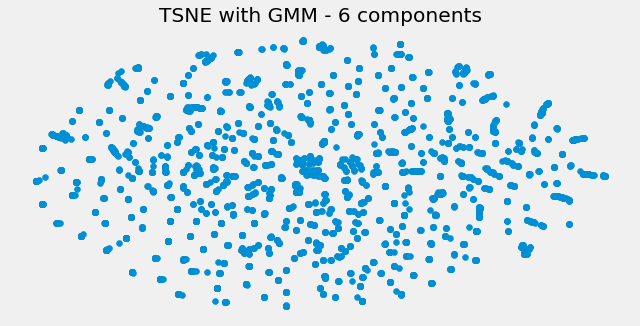

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(tsne_gmm_mm[:, 0], tsne_gmm_mm[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("TSNE with GMM - 6 components")
plt.show()

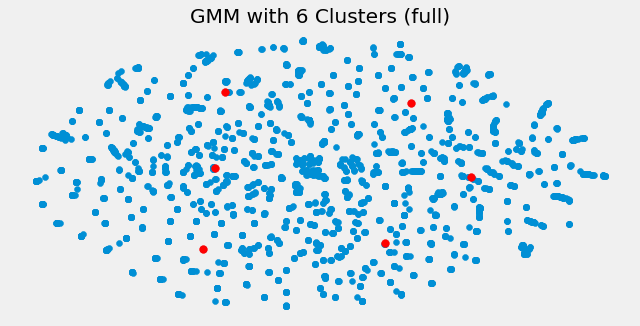

In [ ]:
gmm_cluster_cnt_tsne= mixture.GaussianMixture(n_components=6, covariance_type='full').fit(tsne_gmm_mm) 
centers = np.empty(shape=(gmm_cluster_cnt_tsne.n_components, tsne_gmm_mm.shape[1]))
# for i in range(gmm_cluster.n_components):
#     density = scipy.stats.multivariate_normal(cov=gmm_cluster.covariances_[i], mean=gmm_cluster.means_[i]).logpdf(pca_gmm)
#     centers[i, :] = pca_gmm[np.argmax(density)]

for i in range(gmm_cluster_cnt_tsne.n_components):
    density = scipy.stats.multivariate_normal(cov=gmm_cluster_cnt_tsne.covariances_[i], mean=gmm_cluster_cnt_tsne.means_[i]).logpdf(tsne_gmm_mm)
    centers[i, :] = tsne_gmm_mm[np.argmax(density)]

plt.figure(figsize=(10,5))
plt.scatter(tsne_gmm_mm[:, 0], tsne_gmm_mm[:, 1])
plt.scatter(centers[:, 0], centers[:, 1], s=60, color='red')
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("GMM with 6 Clusters (full)")
plt.show()

NO DEFINED 6-CLUSTERS FOR TSNE VERSIONS EITHER.

In [ ]:
gmm_sil_tsne= metrics.silhouette_score(tsne_gmm_mm,cluster6_tsne_gmm, metric='euclidean')
gmm_sil_tsne

0.3571106

LOWER THAN KMEANS PCA

# UMAP FOR GMM

In [ ]:
#UMAP REDUCTION
umap_gmm = umap.UMAP(n_neighbors=4,
                      min_dist=0.3,
                      metric='correlation').fit_transform(X_scaled_mm)
                      
#min_dist was 0.3


In [ ]:
# FIT THE MODEL TO THE UMAP REDUCTION
cluster6_umap_gmm = gmm_cluster.fit_predict(umap_gmm)

In [ ]:
plt.figure(figsize=(10,5))
colours = "r","b","g","c","m","y","k","r","burlywood","chartreuse"
for i in range(umap_gmm.shape[0]):
    plt.text(umap_gmm[i, 0], umap_gmm[i, 1], str(cluster6_umap_gmm[i]),
             color=colours[cluster6_umap_gmm[i]],
             fontdict={'weight': 'bold', 'size': 50}
        )

plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("GMM WITH UMAP: 6 clusters")
plt.show()

6 DEFINED CLUSTERS BUT ONLY BY COLOR

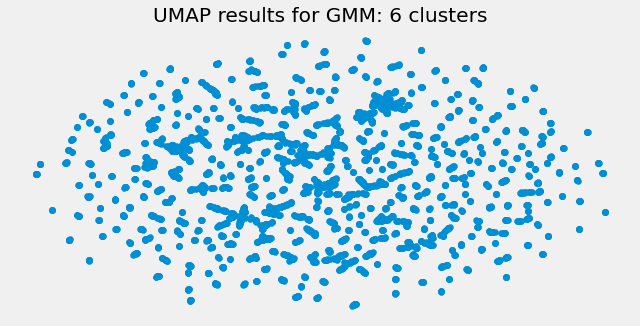

In [ ]:
plt.figure(figsize=(10,5))
plt.scatter(umap_gmm[:, 0], umap_gmm[:, 1])
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("UMAP results for GMM: 6 clusters")
plt.show()

**NO 6 CLEARLY DEFINED CLUSTERS**

---



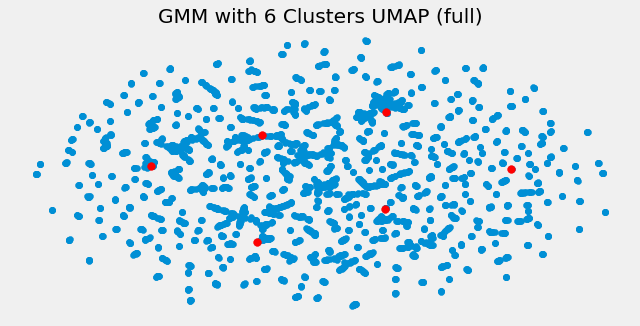

In [ ]:
gmm_cluster_cnt_umap= mixture.GaussianMixture(n_components=6, covariance_type='full').fit(umap_gmm) 
centers = np.empty(shape=(gmm_cluster_cnt_umap.n_components, umap_gmm.shape[1]))
for i in range(gmm_cluster_cnt_umap.n_components):
    density = scipy.stats.multivariate_normal(cov=gmm_cluster_cnt_umap.covariances_[i], mean=gmm_cluster_cnt_umap.means_[i]).logpdf(umap_gmm)
    centers[i, :] = umap_gmm[np.argmax(density)]

plt.figure(figsize=(10,5))
plt.scatter(umap_gmm[:, 0], umap_gmm[:, 1])
plt.scatter(centers[:, 0], centers[:, 1], s=60, color='red')
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.title("GMM with 6 Clusters UMAP (full)")
plt.show()

EVEN WITH CLUSTERS DEFINED - CANNOT SEE 6 CLEARLY DEFINED CLUSTERS

In [ ]:
gmm_sil_umap= metrics.silhouette_score(umap_gmm,cluster6_umap_gmm, metric='euclidean')
gmm_sil_umap

0.31871215

STILL LOWER THAN KMEANS PCA

In [ ]:
comparison_chart=pd.DataFrame({"KMEANS":[pca_km_mm_sil,tsne_km_mm_sil, umap_km_mm_sil],
                 "AGG CL":[agg_sil_pca,agg_sil_tsne,agg_sil_umap],
                 "DBSCAN":[dbscan_sil_pca,dbscan_sil_tsne,dbscan_sil_umap],
                 "GMM":[gmm_sil_spherical,gmm_sil_tsne,gmm_sil_umap]
                 }).round(3)
comparison_chart.index = ['PCA', 'TSNE', 'UMAP']
comparison_chart

,KMEANS,AGG CL,DBSCAN,GMM
PCA,0.615,0.488,0.503,0.619
TSNE,0.368,0.320,0.400,0.357
UMAP,0.360,0.314,-0.115,0.319


#<FONT COLOR = 'BLUE'> CONCLUSION </FONT>

<font color = 'red'>**OVERALL - USING PCA WITH ALL CLUSTERING METHODS PRODUCED THE MOST DISTINCT CLUSTERS IN QUANTITY CLOSEST WHAT WAS DETERMINED VIA ELBOW OR DENDROGRAM - WHICH WAS USUALLY 6 CLUSTERS.** </font>

AFTER RUNNING ALL MODELS AND DIMENSIONALITY REDCUERS - 

**I WOULD GO WITH RESULTS OF KMEANS PCA BASED ON VISUALIZATIONS AND SILHOUETTE SCORE // GMM PCA DOING BEST**

When determining best cluster model to use - I would use Silhouette score for final decision - and go with DBSCAN with PCA dimensionality reduction. It consistently produced a higher Silhouette score. Since there is no defined y, or target, in this clustering analysis, Adjusted Rand Index (ARI) would not be considered. 
